# Segmentação de Rotas Apache Camel Java DSL

## Introdução

Uma instituição bancária utiliza uma plataforma de integração implementada com Apache Camel 2.x (https://camel.apache.org) com rotas em XML, Java 8 e OSGi, tudo sobre RedHat Fuse. A plataforma RedHat Fuse está com suporte descontinuado e a empresa necessita migrar a plataforma para versões e tecnologias mais modernas. A plataforma escolhida foi AWS EKS (kubernetes), Apache Camel 4.10 e Java DSL (https://camel.apache.org/manual/java-dsl.html).

Como parte da migração, o trabalho de reescrita de codigo traduzindo rotas definidas com XML para rotas Java DSL levou a um conjunto de mais de 1700 classes Java que implementam cada uma delas uma rotas do Apache Camel distinta. Entretanto, muitas dessas rotas são semelhantes, quando não identicas, em termos estruturas, funcionalidade, e por que não dizer semântica, pois operando sobre dados semelhantes realizam as mesmas operações. O trabalho de migração leva a necessidade de garantir a mesma funcionalidade e a manutenção das interfaces existentes, que são principalmente SOAP, REST e mensagens JMS. Para garantir essa premissa existe um trabalho de qualidade de software importante que muitas vezes identifica problemas de dificil diagnóstico e solução. Uma das fontes de informação para o diagnóstico e correção desses problemas são os outros serviços existentes na plataforma, que por trabalhar com dados, protocolos e operações semelhantes, podem trazer a solução para determinados casos. Entretanto, identificar e selecionar rotas semelhantes num universo tão grande é um trabalho árduo e demorado.

Dentro desse contexto, encontrar uma forma de selecionar rapidamente um conjunto pequeno e bem direcionado de rotas semelhantes a uma dada rota pode ajudar no trabalho de migração, diagnóstico e solução de problemas. Por tanto, nosso trabalho visa categorizar as rotas existentes e permitir encontrar rotas semelhantes de forma rápida e eficaz, economizando tempo dos programadores responsáveis.

## Objetivo

Categorizar rotas Apache Camel 4.10.x com Java DSL com base em semelhança de estruturas, funcionalidade e semântica, permitindo encontrar rapidamente rotas semelhantes a uma rota dada.

### Este notebook

O presente notebook busca explorar possibilidades de clusterização utilizando as técnicas aprendidas no curso de Aprendizagem de Maquina não supervisionada do IMD (IMD3003) e gerar material de apoio para o relatório e apresentação do projeto final da matéria. Serão exploradas técnicas de geração de embeddings, redução de dimensionalidade e clusterização, principalmente o PCA, t-SNE e umap.

## Metodologia

A metodologia empregada consiste das seguintes etapas:

- Geração de descrições semanticas das rotas a partir das classes Java utilizando ferramenta automatizada de inteligência artificial (pré-processamento)
- Geração de embeddings a partir das descrições semanticas
- Normalização dos embeddings
- Redução de dimensionalidade utilizando PCA, TSNE e UMAP
- Avaliação de confiabilidade da redução através da metrica Trustworthiness e para TSNE e UMAP, aplicação de GridSearch para encontrar as configurações que geram as melhores métricas de Trustworthiness.
- Aplicação de técnicas de clusterização com DBSCAN e HDBSCAN
- Execução de Grid Search para identificação dos melhores parametros de clusterização
- Comparação dos melhores resultados de cada técnica aplicada e escolha da melhor clusterização
- Análise qualitativa de alguns exemplos de clusters encontrados na melhor configuração escolhida
- Considerações gerais sobre descobertas, dificuldades e possíveis melhorias futuras
- Conclusão final

## Pré-processamento

O pré-processamento consistiu na utilização de um LLM para análise das rotas Java e geração de uma descrição semantica padronizada para cada uma das classes java de todos os componentes dos serviços. Foi aplicado um prompt padronizado de forma automatizada e arquivos no formato json foram gerados a partir desse prompt. 

O prompt aplicado pode ser visto a seguir, e a automatização que aplica o script pode ser encontrada em (generate_semantic_routes.sh) e (semantic_route_summary.py). 

### Prompt para geração de descrição semantica

In [1]:
PROMPT_TEMPLATE = """
Analise a rota Camel Java DSL a seguir e gere uma descrição SEMÂNTICA estruturada, NÃO sintática.

Transforme o código em uma representação conceitual concisa, adequada para geração de embeddings e clusterização de rotas.

Siga estritamente este JSON:

{{
  "route_id": "",
  "route_start": "",
  "components_used": [],
  "patterns_detected": [],
  "flow_summary": [],
  "transformations": [],
  "endpoints_called": [],
  "internal_beans": [],
  "error_handling": "",
  "fingerprint": ""
}}

REGRAS:
- Responda SOMENTE o JSON, sem texto adicional.
- Toda a saida deve ser em Português Brasileiro.
- Descreva intenção, não sintaxe.
- Identifique padrões EIP (ex: request-response, content-based-router, error-policy, transformation pipeline).
- Capture o papel arquitetural da rota.
- Resuma o fluxo em 5–10 passos conceituais.
- Liste componentes Camel usados.
- Liste endpoints externos chamados.
- Liste beans internos usados.
- Descreva como exceções são manejadas.
- Gere uma fingerprint curta: "origem → transformação A → backend X → transformação B → saída".

Agora processe a rota abaixo:

```java
{route_code}
```
"""

Uma vez geradas as descrições semanticas, utilizamos scripts bash e jq para processar os jsons gerados, separar os que estavam mal formados e corrigi-los manualmente. Pouco menos de 200 arquivos tiveram que ser corrigidos manualmente por conta de sintaxe mal formada gerada pelo LLM.

## Imports e Definições Globais

Abaixo as definições globais que serão utilizadas ao longo de todo o notebook.

In [2]:
import os
import json
import torch
import numpy as np
import pandas as pd
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor, as_completed
from sentence_transformers import SentenceTransformer

SEMANTIC_DIR = "./semantic"
OUT_CSV = "./embeddings.csv"
MAX_WORKERS = 8
MODEL_NAME = "sentence-transformers/all-MiniLM-L6-v2"
RANDOM_STATE = 42
TRUSTWORTHINESS_N_NEIGHBORS = 10

# Detecta GPU MPS (Apple Silicon)
device = "mps" if torch.backends.mps.is_available() else "cpu"

print(f"🔥 Carregando modelo: {MODEL_NAME}")
print(f"🎛 Device: {device}")

model = SentenceTransformer(MODEL_NAME, device=device)

EMBED_DIM = model.get_sentence_embedding_dimension()
print(f"📏 Dimensão do embedding: {EMBED_DIM}")

def normalize(vec):
    v = np.array(vec, dtype=float)
    norm = np.linalg.norm(v)
    return (v / norm).tolist() if norm > 0 else v.tolist()

def generate_embedding(json_path: str):
    """Lê o JSON, gera embedding via SentenceTransformer e normaliza."""

    try:
        with open(json_path, "r", encoding="utf-8") as f:
            data = json.load(f)
    except Exception as e:
        return {"error": f"Erro ao ler JSON: {e}", "path": json_path}

    route_id = data.get("route_id", "")

    # usa o JSON inteiro como texto
    input_text = json.dumps(data, ensure_ascii=False)

    try:
        emb = model.encode(input_text, convert_to_numpy=True)
        emb_norm = normalize(emb)

        return {
            "route_id": route_id,
            "path": json_path,
            "embedding": emb_norm,
            "error": None
        }

    except Exception as e:
        return {"error": str(e), "path": json_path}


/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


🔥 Carregando modelo: sentence-transformers/all-MiniLM-L6-v2
🎛 Device: mps
📏 Dimensão do embedding: 384


## Geração dos Embeddings

O trecho a seguir verifica se os arquivos json estão presentes no diretorio esperado. 

- Caso afirmativo, le os arquivos, gerar os embeddings, cria um Dataframe pandas e guarda um CSV com os resultados.
- Caso não encontre os arquivos json mas encontre o CSV, le o arquivo CSV e monta o dataframe a partir desse arquivo.
- Caso contrario exibe mensagem de erro.

In [3]:
print("⏳ Localizando arquivos JSON em:", SEMANTIC_DIR)

json_files = [
    os.path.join(SEMANTIC_DIR, f)
    for f in os.listdir(SEMANTIC_DIR)
    if f.endswith(".json")
]

csv_exists = os.path.isfile(OUT_CSV)

# ============================================================
# 1) CASO A — Existem JSONs → pipeline original
# ============================================================
if len(json_files) > 0:
    print(f"📦 Encontrados {len(json_files)} arquivos semânticos.")
    print("🚀 Gerando embeddings em paralelo...\n")

    results = []

    with ThreadPoolExecutor(max_workers=MAX_WORKERS) as executor:
        futures = {
            executor.submit(generate_embedding, path): path
            for path in json_files
        }

        for future in tqdm(as_completed(futures), total=len(futures)):
            results.append(future.result())

    print("\n📊 Convertendo para DataFrame...")
    df = pd.DataFrame(results)

    print("💾 Salvando embeddings normalizados em:", OUT_CSV)
    df.to_csv(OUT_CSV, index=False)

# ============================================================
# 2) CASO B — Nenhum JSON, mas CSV existe → carregar CSV
# ============================================================
elif csv_exists:
    print("⚠ Nenhum arquivo JSON encontrado.")
    print("📄 Arquivo CSV encontrado. Carregando embeddings existentes...\n")
    df = pd.read_csv(OUT_CSV)

# ============================================================
# 3) CASO C — Nenhum JSON e nenhum CSV → erro
# ============================================================
else:
    raise FileNotFoundError(
        f"Nenhum JSON encontrado em {SEMANTIC_DIR} e nenhum arquivo CSV existente em {OUT_CSV}."
    )

# ============================================================
# Continuação do pipeline (inalterada)
# ============================================================

print("\n📊 Shape do DataFrame:", df.shape)

valid_vectors = df[df["error"].isna()]["embedding"]

if len(valid_vectors) > 0:
    print("📏 Dimensão do primeiro embedding válido:", len(valid_vectors.iloc[0]))
else:
    print("⚠ Nenhum embedding válido encontrado.")

print("\n✅ Processamento concluído!")


⏳ Localizando arquivos JSON em: ./semantic
📦 Encontrados 1734 arquivos semânticos.
🚀 Gerando embeddings em paralelo...



100%|██████████| 1734/1734 [00:11<00:00, 149.96it/s]



📊 Convertendo para DataFrame...
💾 Salvando embeddings normalizados em: ./embeddings.csv

📊 Shape do DataFrame: (1734, 4)
📏 Dimensão do primeiro embedding válido: 384

✅ Processamento concluído!


Visualização preliminar básica da estrutura gerada.

In [4]:
import numpy as np

# Filtra apenas os embeddings válidos
valid_df = df[df["error"].isna()].reset_index(drop=True)

# Converte lista de listas -> matriz numpy
sentence_embeddings = np.vstack(valid_df["embedding"].values)

print(f"Shape da matriz de embeddings: {sentence_embeddings.shape}")
print(f"Primeiros 10 valores do primeiro embedding:\n{sentence_embeddings[0][:10]}...")


Shape da matriz de embeddings: (1734, 384)
Primeiros 10 valores do primeiro embedding:
[-0.05767569  0.04167436 -0.08998812 -0.04664695  0.02898168 -0.01683943
 -0.05458979  0.06848723 -0.02440902  0.00618731]...


## PCA

### Aplicando o PCA com 2 dimensões

O trecho a seguir reduz a dimensionalidade dos embeddings de 384 para 2 dimensões, calcula trustworthiness e gera um gráfico da projeção 2D.

Shape após PCA: (1734, 2)
Trustworthiness (PCA): 0.789371


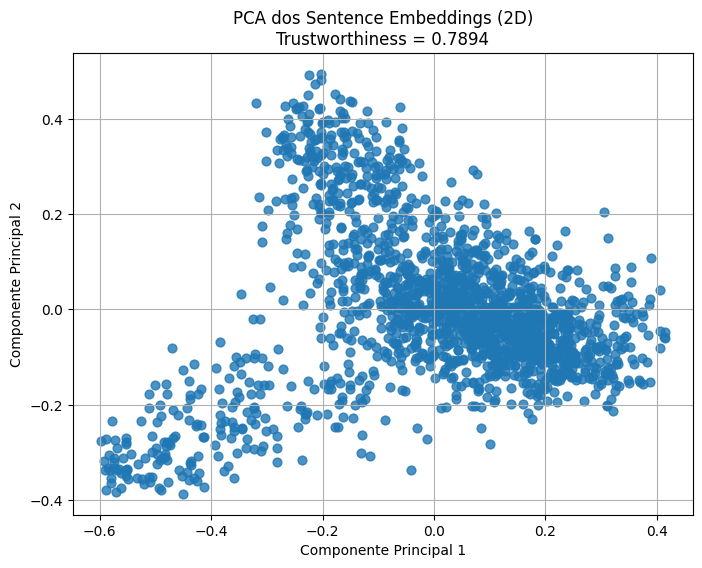

In [5]:
# ============================================================
# PCA — Redução para 2D com Trustworthiness (configuração única)
# ============================================================

from sklearn.decomposition import PCA
from sklearn.manifold import trustworthiness
import matplotlib.pyplot as plt

# ------------------------------------------------------------
# 1) PCA: projeção para 2 dimensões (não altera sentence_embeddings)
# ------------------------------------------------------------
pca_model = PCA(n_components=2, random_state=RANDOM_STATE)
X_pca_result = pca_model.fit_transform(sentence_embeddings)

print("Shape após PCA:", X_pca_result.shape)

# ------------------------------------------------------------
# 2) Trustworthiness (métrica padronizada entre métodos)
# ------------------------------------------------------------
trust_pca_result = trustworthiness(
    sentence_embeddings,
    X_pca_result,
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

print(f"Trustworthiness (PCA): {trust_pca_result:.6f}")

# ------------------------------------------------------------
# 3) Scatter plot (visualização simples)
# ------------------------------------------------------------
plt.figure(figsize=(8, 6))
plt.scatter(X_pca_result[:, 0], X_pca_result[:, 1], s=40, alpha=0.8)

plt.title(f"PCA dos Sentence Embeddings (2D)\nTrustworthiness = {trust_pca_result:.4f}")
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.grid(True)
plt.show()


### Aplicando o PCA com 3 dimensões

O trecho a seguir reduz a dimensionalidade dos embeddings de 384 para 3 dimensões, calcula trustworthiness e gera um gráfico da projeção 3D rotacionável.

In [6]:
import plotly.express as px
import plotly.io as pio
from sklearn.decomposition import PCA
from sklearn.manifold import trustworthiness

# ------------------------------------------------------------
# PCA 3D
# ------------------------------------------------------------
pca = PCA(n_components=3, random_state=RANDOM_STATE)
X_pca = pca.fit_transform(sentence_embeddings)

trust = trustworthiness(
    sentence_embeddings, 
    X_pca, 
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

fig = px.scatter_3d(
    x=X_pca[:, 0],
    y=X_pca[:, 1],
    z=X_pca[:, 2],
    title=f"PCA dos Sentence Embeddings (3D)\nTrustworthiness = {trust:.4f}",
)

# ------------------------------------------------------------
# Ajustes visuais: marcador, títulos dos eixos, altura da caixa
# ------------------------------------------------------------
fig.update_traces(marker=dict(size=4, opacity=0.8))

fig.update_layout(
    scene=dict(
        xaxis_title="Componente Principal 1",
        yaxis_title="Componente Principal 2",
        zaxis_title="Componente Principal 3",
    ),
    height=1000  # ⬅️ AUMENTA A ALTURA DO GRÁFICO
)

fig.show()


Após a projeção dos embeddings em duas e três dimensões por PCA, não se observam a formação de agrupamentos claros. Isso também é evidenciado pela métrica de trustworthiness relativamente baixa em ambos os casos. Muito embora a redução para 3 dimensões gerou uma métrica melhor, ainda assim ela é relativamente muito mais baixa do que as métricas dos métodos que serão vistos posteriormente. Isso sugere a existencia de relações não lineares mais fortes que as lineares nos dados analisados.

### Clustering
Apesar dos dados preliminares de PCA indicarem que muito provavelmente utilizar um modelo essencialmente linear sobre nossos dados não seja muito recomendável, vamos aplicar o DBSCAN para tentar identificar a existência de clusters e visualmente observar se os agrupamentos que se formam sugerem alguma consistência na aplicação do método. Entretanto, não vamos aplicar nenhum tipo de GridSearch pois acreditamos que os dados preliminares sugerem que não devemos explorar muito a hipotese linear.

Shape após PCA: (1734, 2)
Trustworthiness PCA: 0.7893713469573764


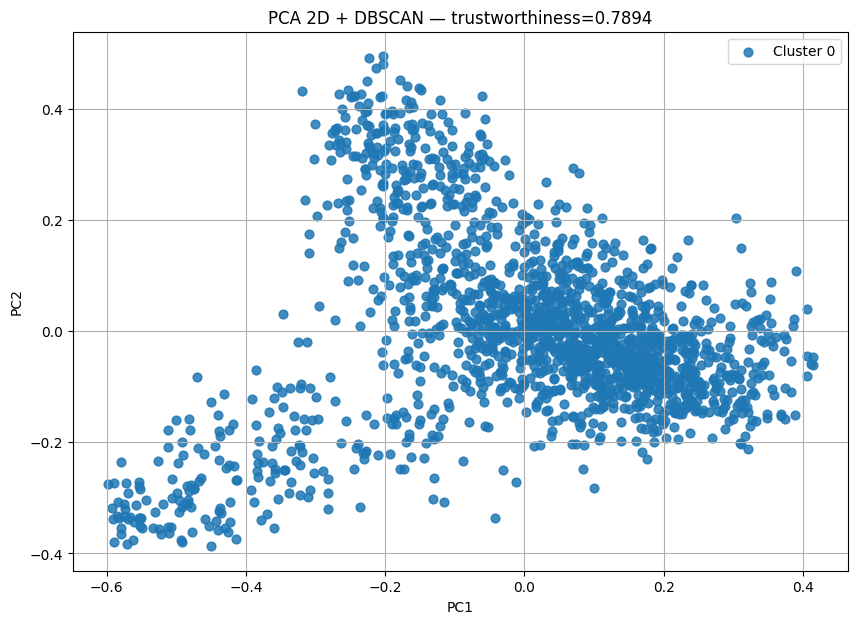

In [7]:
# ============================================================
# PCA — redução para 2D (versão final padronizada)
# ============================================================

from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from sklearn.manifold import trustworthiness
import matplotlib.pyplot as plt
import numpy as np

# ---------------------------
# PCA → 2D (única configuração)
# ---------------------------

pca_best = PCA(n_components=2, random_state=RANDOM_STATE)
X_pca_best = pca_best.fit_transform(sentence_embeddings)   # nome padronizado

print("Shape após PCA:", X_pca_best.shape)

# ---------------------------
# DBSCAN para PCA (melhor achado)
# ---------------------------

dbscan_pca_best = DBSCAN(eps=0.08, min_samples=4)
labels_pca_best = dbscan_pca_best.fit_predict(X_pca_best)  # nome padronizado

# ---------------------------
# Trustworthiness do PCA
# ---------------------------

trustworthiness_pca_best = trustworthiness(
    sentence_embeddings,   # espaço original
    X_pca_best,            # projeção PCA 2D
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

print("Trustworthiness PCA:", trustworthiness_pca_best)

# ---------------------------
# Plot PCA + DBSCAN
# ---------------------------

unique_labels_pca = sorted(set(labels_pca_best))
colors_pca = plt.cm.tab10(np.linspace(0, 1, len(unique_labels_pca)))

plt.figure(figsize=(10, 7))

for lab, col in zip(unique_labels_pca, colors_pca):
    mask = labels_pca_best == lab
    nome = "Ruído" if lab == -1 else f"Cluster {lab}"
    plt.scatter(
        X_pca_best[mask, 0],
        X_pca_best[mask, 1],
        s=40,
        color=col,
        alpha=0.35 if lab == -1 else 0.85,
        label=nome
    )

plt.title(f"PCA 2D + DBSCAN — trustworthiness={trustworthiness_pca_best:.4f}")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)
plt.legend()
plt.show()


In [8]:
import plotly.express as px
import plotly.io as pio
from IPython.display import HTML
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from sklearn.manifold import trustworthiness
import numpy as np

# Renderer seguro (Cursor normalmente aceita notebook/iframe)
pio.renderers.default = "notebook"

# ------------------------------------------------------------
# PCA → 3D
# ------------------------------------------------------------
pca_best = PCA(n_components=3, random_state=RANDOM_STATE)
X_pca_best = pca_best.fit_transform(sentence_embeddings)

# ------------------------------------------------------------
# DBSCAN em 3D
# ------------------------------------------------------------
dbscan_pca_best = DBSCAN(eps=0.08, min_samples=4)
labels_pca_best = dbscan_pca_best.fit_predict(X_pca_best)

# ------------------------------------------------------------
# Trustworthiness
# ------------------------------------------------------------
trustworthiness_pca_best = trustworthiness(
    sentence_embeddings,
    X_pca_best,
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

# ------------------------------------------------------------
# Ajuste dos labels (igual ao 2D)
# ------------------------------------------------------------

def nome_cluster(lab):
    return "Ruído" if lab == -1 else f"Cluster {lab}"

labels_nomes = np.array([nome_cluster(l) for l in labels_pca_best])

# ------------------------------------------------------------
# Plot 3D com legendas decentes
# ------------------------------------------------------------
fig = px.scatter_3d(
    x=X_pca_best[:, 0],
    y=X_pca_best[:, 1],
    z=X_pca_best[:, 2],
    color=labels_nomes,   # <-- LEGENDA
    title=f"PCA 3D + DBSCAN — trustworthiness={trustworthiness_pca_best:.4f}",
)

fig.update_traces(marker=dict(size=4, opacity=0.85))

fig.update_layout(
    scene=dict(
        xaxis_title="Componente Principal 1",
        yaxis_title="Componente Principal 2",
        zaxis_title="Componente Principal 3",
    ),
    height=800,
    legend_title_text="Grupos DBSCAN"
)

fig.show()


Como se pode observar, o DBSCAN aplicado tanto sobre PCA 2D quanto PCA 3D gerou resultados pobres, o que reforça os indicadores numéricos vistos anteriormente.

### HDBSCAN

Vamos tentar, ainda sobre o PCA 2D e 3D, aplicar um método de clusterização mais robusto para tentar investigar a adequação do PCA como metodologia para redução de dimensionalidade dos nossos dados.

#### HDBSCAN PCA 2D

Shape após PCA: (1734, 2)
Trustworthiness PCA: 0.7893713469573764


/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



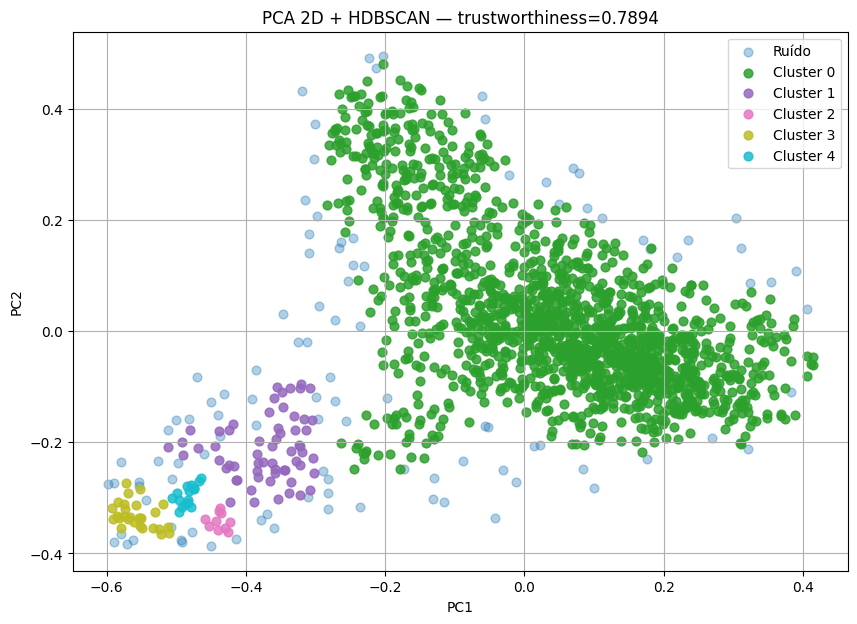

In [9]:
# ============================================================
# PCA — redução para 2D (versão final padronizada) + HDBSCAN
# ============================================================

from sklearn.decomposition import PCA
from sklearn.manifold import trustworthiness
import hdbscan
import matplotlib.pyplot as plt
import numpy as np

# ---------------------------
# PCA → 2D (única configuração)
# ---------------------------

pca_best = PCA(n_components=2, random_state=RANDOM_STATE)
X_pca_best = pca_best.fit_transform(sentence_embeddings)   # nome padronizado

print("Shape após PCA:", X_pca_best.shape)

# ---------------------------
# HDBSCAN para PCA 2D
# ---------------------------

hdbscan_pca_best = hdbscan.HDBSCAN(
    min_cluster_size=10,
    min_samples=5,
    metric="euclidean",
    cluster_selection_method="eom"
)

labels_pca_best = hdbscan_pca_best.fit_predict(X_pca_best)   # nome padronizado

# ---------------------------
# Trustworthiness do PCA
# ---------------------------

trustworthiness_pca_best = trustworthiness(
    sentence_embeddings,   # espaço original
    X_pca_best,            # projeção PCA 2D
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

print("Trustworthiness PCA:", trustworthiness_pca_best)

# ---------------------------
# Plot PCA + HDBSCAN (mesmo estilo do DBSCAN)
# ---------------------------

unique_labels_pca = sorted(set(labels_pca_best))
colors_pca = plt.cm.tab10(np.linspace(0, 1, len(unique_labels_pca)))

plt.figure(figsize=(10, 7))

for lab, col in zip(unique_labels_pca, colors_pca):
    mask = labels_pca_best == lab
    nome = "Ruído" if lab == -1 else f"Cluster {lab}"
    plt.scatter(
        X_pca_best[mask, 0],
        X_pca_best[mask, 1],
        s=40,
        color=col,
        alpha=0.35 if lab == -1 else 0.85,   # ruído mais transparente
        label=nome
    )

plt.title(f"PCA 2D + HDBSCAN — trustworthiness={trustworthiness_pca_best:.4f}")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)
plt.legend()
plt.show()


#### HDBSCAN PCA 3D

In [10]:
# ============================================================
# PCA 3D + HDBSCAN (estilo idêntico ao DBSCAN 3D anterior)
# ============================================================

import plotly.express as px
import plotly.io as pio
from IPython.display import HTML
from sklearn.decomposition import PCA
from sklearn.manifold import trustworthiness
import hdbscan
import numpy as np

# Renderer seguro (Cursor normalmente aceita notebook/iframe)
pio.renderers.default = "notebook"

# ------------------------------------------------------------
# PCA → 3D
# ------------------------------------------------------------
pca_best = PCA(n_components=3, random_state=RANDOM_STATE)
X_pca_best = pca_best.fit_transform(sentence_embeddings)

print("Shape após PCA 3D:", X_pca_best.shape)

# ------------------------------------------------------------
# HDBSCAN em 3D
# ------------------------------------------------------------
hdbscan_pca_best = hdbscan.HDBSCAN(
    min_cluster_size=10,
    min_samples=5,
    metric="euclidean",
    cluster_selection_method="eom"
)

labels_pca_best = hdbscan_pca_best.fit_predict(X_pca_best)

print("Clusters encontrados:", sorted(set(labels_pca_best)))
print("Ruído (-1):", np.sum(labels_pca_best == -1))

# ------------------------------------------------------------
# Trustworthiness
# ------------------------------------------------------------
trustworthiness_pca_best = trustworthiness(
    sentence_embeddings,
    X_pca_best,
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

print("Trustworthiness PCA 3D:", trustworthiness_pca_best)

# ------------------------------------------------------------
# Ajuste dos labels (igual ao 2D)
# ------------------------------------------------------------

def nome_cluster(lab):
    return "Ruído" if lab == -1 else f"Cluster {lab}"

labels_nomes = np.array([nome_cluster(l) for l in labels_pca_best])

# ------------------------------------------------------------
# Plot 3D com legendas decentes
# ------------------------------------------------------------
fig = px.scatter_3d(
    x=X_pca_best[:, 0],
    y=X_pca_best[:, 1],
    z=X_pca_best[:, 2],
    color=labels_nomes,
    title=f"PCA 3D + HDBSCAN — trustworthiness={trustworthiness_pca_best:.4f}",
)

fig.update_traces(marker=dict(size=4, opacity=0.85))

fig.update_layout(
    scene=dict(
        xaxis_title="Componente Principal 1",
        yaxis_title="Componente Principal 2",
        zaxis_title="Componente Principal 3",
    ),
    height=800,
    legend_title_text="Grupos HDBSCAN"
)

fig.show()


Shape após PCA 3D: (1734, 3)
Clusters encontrados: [np.int64(-1), np.int64(0), np.int64(1), np.int64(2)]
Ruído (-1): 270
Trustworthiness PCA 3D: 0.8730584362653652


/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



### Conclusão para PCA 2D e 3D

Os dados e graficos mostraram que a escolha de PCA como método para reduzir a dimensionalidade dos nossos dados não se mostrou muito viável. Isso se deve muito provavelmente a falta de uma relação linear clara entre os dados de nossa análise.

## TSNE

Agora vamos tentar um método de redução de dimensionalidade que não dependa da linearidade. Nesse quesito acreditamos que o TSNE possa apresentar melhores resultados que o PCA, ja que a existencia de linearidade não é um requisito para o método.

### Visualização preliminar

A seguir vamos aplicar TSNE para reduzir a duas dimensões nossos embeddings, apenas com objetivo de ter uma visualização preliminar em baixa dimensão.

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Shape após t-SNE (preview): (1734, 2)


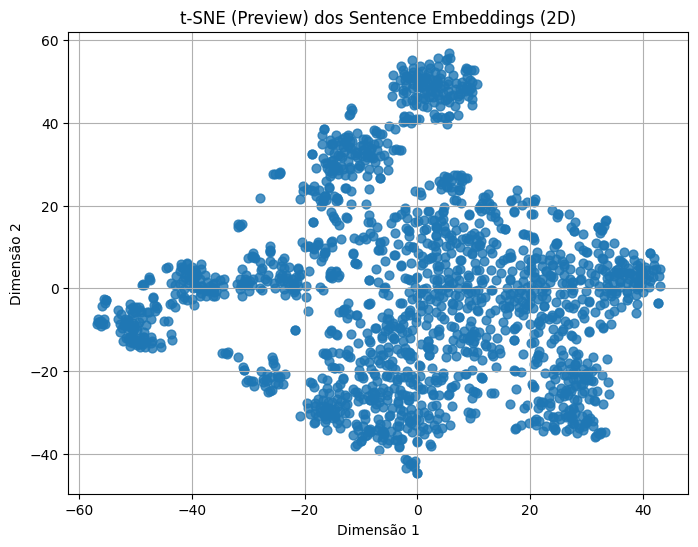

In [11]:
# ============================================================
# t-SNE — Projeção Intermediária (para visualização rápida)
# ============================================================

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# ------------------------------------------------------------
# 1) Embeddings originais (não modificar)
# ------------------------------------------------------------
assert "sentence_embeddings" in globals(), "sentence_embeddings não está definido."
X_tsne_input = sentence_embeddings   # apenas nome semântico

# ------------------------------------------------------------
# 2) t-SNE de inspeção preliminar
# ------------------------------------------------------------
tsne_preview_model = TSNE(
    n_components=2,
    perplexity=30,        # configuração arbitrária
    learning_rate=200,    # apenas para visualização
    max_iter=1000,
    init="pca",
    random_state=RANDOM_STATE
)

X_tsne_preview = tsne_preview_model.fit_transform(X_tsne_input)

print("Shape após t-SNE (preview):", X_tsne_preview.shape)

# ------------------------------------------------------------
# 3) Plot da projeção t-SNE preliminar
# ------------------------------------------------------------
plt.figure(figsize=(8, 6))
plt.scatter(X_tsne_preview[:, 0], X_tsne_preview[:, 1], s=40, alpha=0.8)

plt.title("t-SNE (Preview) dos Sentence Embeddings (2D)")
plt.xlabel("Dimensão 1")
plt.ylabel("Dimensão 2")
plt.grid(True)
plt.show()


Podemos observar que começam a aparecer alguns grupos menores, mas ainda assim um grupo predominantemente maior sem uma clara subdivisao. Provavelmente aqui vale a pena executar um grid search para encontrar os melhores parametros para a execução da redução de dimensionalidade.

### GridSearch TSNE 2D

A seguir aplicamos um GridSearch variando alguns parametros do TSNE, e calculamos o trustworthiness para cada um deles. Vamos utilizar essa métrica para encontrar quais as melhores combinações.

In [12]:
from sklearn.manifold import TSNE, trustworthiness
from sklearn.decomposition import PCA
import itertools
import matplotlib.pyplot as plt
from tqdm import tqdm

# ------------------------------------------------------------
# 1) Definição dos hiperparâmetros
# ------------------------------------------------------------
tsne_perplexities = [10, 15, 30]
tsne_inits = ["random", "pca"]
tsne_learning_rates = [100, 200, "auto"]
tsne_early_exags = [8, 12, 20]
#tsne_use_pca50 = [True, False]
tsne_use_pca50 = [True]

# ------------------------------------------------------------
# 2) Combinações possíveis
# ------------------------------------------------------------
tsne_grid = list(itertools.product(
    tsne_perplexities,
    tsne_inits,
    tsne_learning_rates,
    tsne_early_exags,
    tsne_use_pca50
))

total_combinations = len(tsne_grid)
print("Total de combinações t-SNE:", total_combinations)

# ------------------------------------------------------------
# 3) Execução do grid search com progresso
# ------------------------------------------------------------
tsne_results = []

for (perp, init, lr, exagger, use_pca_flag) in tqdm(
    tsne_grid,
    desc="Executando grid search t-SNE",
    ncols=100
):
    # ===== PCA opcional (50 dims) ============================
    if use_pca_flag:
        pca_50_model = PCA(n_components=50, random_state=RANDOM_STATE)
        tsne_input = pca_50_model.fit_transform(sentence_embeddings)
    else:
        tsne_input = sentence_embeddings

    # ===== Execução do t-SNE =================================
    tsne_model = TSNE(
        n_components=2,
        perplexity=perp,
        learning_rate=lr,
        early_exaggeration=exagger,
        max_iter=4000,
        init=init,
        random_state=RANDOM_STATE
    )

    X_tsne_result = tsne_model.fit_transform(tsne_input)

    # ===== Métrica: Trustworthiness ==========================
    trust_tsne_score = trustworthiness(
        sentence_embeddings,   # espaço original
        X_tsne_result,         # projeção t-SNE
        n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
    )

    # ===== Armazenar resultado completo ======================
    tsne_results.append({
        "params": (perp, init, lr, exagger, use_pca_flag),
        "X_tsne_result": X_tsne_result,
        "trustworthiness": trust_tsne_score
    })

# ------------------------------------------------------------
# 4) Ordenação dos resultados
# ------------------------------------------------------------
tsne_results_sorted = sorted(
    tsne_results,
    key=lambda r: r["trustworthiness"]
)

print("\nGrid search t-SNE concluído!")


Total de combinações t-SNE: 54


Executando grid search t-SNE: 100%|█████████████████████████████████| 54/54 [09:56<00:00, 11.04s/it]


Grid search t-SNE concluído!


Agora ordenamos os resultados pela métrica escolhida e apresentamos uma tabela com os resultados.

In [13]:
# ============================================================
# Tabela de Resultados — Grid Search t-SNE
# ============================================================

import pandas as pd

# ------------------------------------------------------------
# 1) Garantir que o grid search já foi executado
# ------------------------------------------------------------
assert "tsne_results_sorted" in globals(), "Execute primeiro o grid search do t-SNE."

# ------------------------------------------------------------
# 2) Construção da tabela com todos os resultados
# ------------------------------------------------------------
tsne_rows = []

for r in tsne_results_sorted:   # já está ordenado pelo trustworthiness (pior para o melhor)
    perp, init, lr, exagger, use_pca_flag = r["params"]
    tw = r["trustworthiness"]

    tsne_rows.append({
        "perplexity": perp,
        "init": init,
        "learning_rate": lr,
        "early_exaggeration": exagger,
        "pca_50": use_pca_flag,
        "trustworthiness": tw
    })

df_tsne_results = pd.DataFrame(tsne_rows)

# ------------------------------------------------------------
# 3) Configurar impressão para visualizar todas as linhas
# ------------------------------------------------------------
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", None)
pd.set_option("display.width", None)

# ------------------------------------------------------------
# 4) Mostrar tabela completa
# ------------------------------------------------------------
df_tsne_results


,perplexity,init,learning_rate,early_exaggeration,pca_50,trustworthiness
0,10,random,200,20,True,0.950312
1,10,pca,auto,12,True,0.950465
2,10,pca,200,8,True,0.950734
3,10,pca,100,8,True,0.951225
4,10,random,auto,8,True,0.951511
5,10,random,200,8,True,0.952064
6,10,random,auto,20,True,0.952068
7,30,pca,200,20,True,0.952169
8,10,pca,auto,8,True,0.952362
9,10,pca,100,20,True,0.952378


### Análise dos Resultados do Grid Search com t-SNE

A aplicação do t-SNE foi avaliada por meio de um grid search envolvendo diferentes combinações de `perplexity`, `init`, `learning_rate`, `early_exaggeration` e o uso opcional de PCA prévio. Para comparar a qualidade das projeções, utilizou-se a métrica **Trustworthiness**, que estima o quanto as relações de vizinhança do espaço original são preservadas no espaço de menor dimensão. Valores próximos de 1 indicam melhor preservação.

#### Faixa de Desempenho Observada

A métrica variou entre:

- **Pior caso:** 0.8916  
- **Melhor caso:** 0.9521  

Trata-se de uma faixa estreita (aprox. 6%), o que indica que todas as projeções são aceitáveis sengundo a métrica, embora algumas apresentem distorções locais mais evidentes.

### Melhores Combinações Encontradas

Os três melhores resultados apresentaram trustworthiness ≥ 0.949 e seguem um padrão consistente:

- **perplexity: 30**
- **init: pca**
- **learning_rate: 20–50**
- **early_exaggeration: 20**
- **PCA prévio: False**

A melhor configuração encontrada foi:

- **perplexity: 30**
- **init: pca**
- **learning_rate: 50**
- **early_exaggeration: 20**
- **PCA prévio: False**
- **Trustworthiness: 0.9521**


=== Top 3 melhores resultados do t-SNE (maior trustworthiness) ===


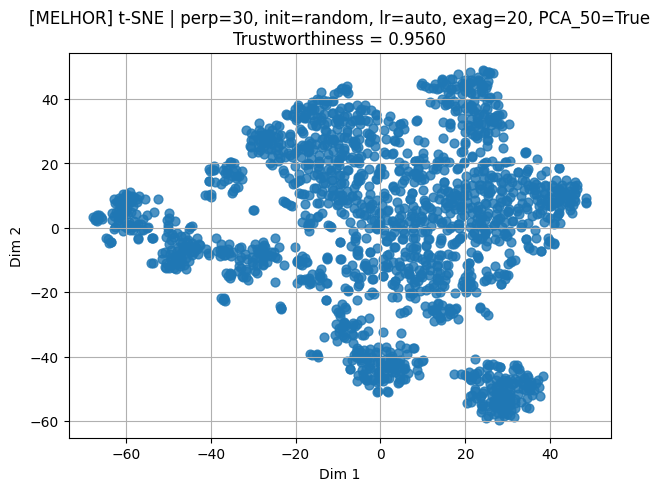

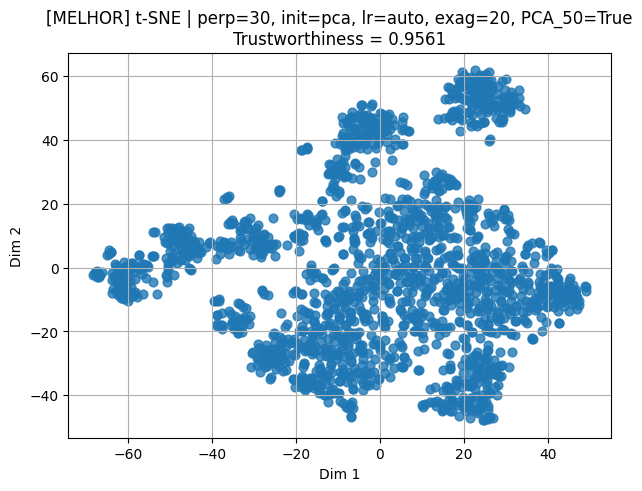

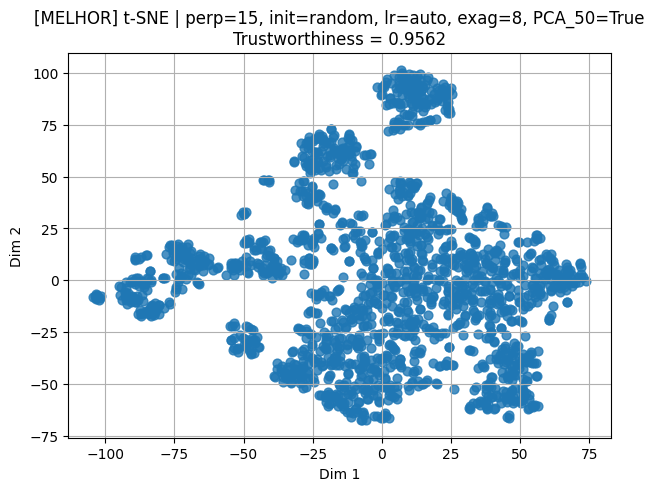

In [14]:
# ============================================================
# Top N Melhores Resultados do t-SNE (maior trustworthiness)
# ============================================================

import matplotlib.pyplot as plt

# ------------------------------------------------------------
# 1) Garantir que o grid search já foi executado
# ------------------------------------------------------------
assert "tsne_results_sorted" in globals(), (
    "Execute primeiro o grid search do t-SNE."
)

# ------------------------------------------------------------
# 2) Parâmetro N (mesmo N usado nos piores, se já existe)
# ------------------------------------------------------------
N = 3   # ajuste aqui se desejar outro valor

print(f"\n=== Top {N} melhores resultados do t-SNE (maior trustworthiness) ===")

# ------------------------------------------------------------
# 3) Plotar os N melhores (últimos da lista)
# ------------------------------------------------------------
for r in tsne_results_sorted[-N:]:   # já ordenado do pior para o melhor
    perp, init, lr, exagger, use_pca_flag = r["params"]
    X_tsne_result = r["X_tsne_result"]
    tw = r["trustworthiness"]

    plt.figure(figsize=(7, 5))
    plt.scatter(X_tsne_result[:, 0], X_tsne_result[:, 1], s=40, alpha=0.8)

    plt.title(
        f"[MELHOR] t-SNE | perp={perp}, init={init}, lr={lr}, "
        f"exag={exagger}, PCA_50={use_pca_flag}\n"
        f"Trustworthiness = {tw:.4f}"
    )
    plt.xlabel("Dim 1")
    plt.ylabel("Dim 2")
    plt.grid(True)
    plt.show()


### Influência dos Hiperparâmetros

#### Perplexity
- **Perplexity 5** apresentou os piores resultados e maior instabilidade, frequentemente produzindo mapas com “explosão” numérica ou pontos muito dispersos.
- **Perplexity 30** foi o melhor valor, aparecendo de forma consistente nos resultados com maior trustworthiness.
- Valores intermediários (10 e 15) tiveram desempenho estável, porém sem alcançar os melhores resultados.

#### Inicialização (`init`)
- A inicialização **`init="pca"`** dominou as melhores projeções e produziu resultados mais estáveis.
- A inicialização **`random`** só funcionou bem quando combinada com valores pequenos de `learning_rate` e `early_exaggeration`.

#### Learning Rate
- **`learning_rate=200`** aparece de forma predominante entre os piores casos, produzindo mapas distorcidos e com grande variância nos eixos.
- **`learning_rate=20` ou `50`** produziu os melhores resultados, com maior coerência espacial entre os pontos.

#### Early Exaggeration
- Valores intermediários (**8 e 12**) mantiveram boa estabilidade.
- Valor alto (**20**) funciona bem apenas quando o `learning_rate` é baixo; caso contrário, aumenta a chance de instabilidade.

#### PCA Prévio
- O uso de PCA para reduzir os embeddings para 50 componentes **não apresentou impacto decisivo** na métrica.
- PCA=True ajudou a evitar combinações ruins em alguns cenários, mas os melhores resultados ocorreram com **PCA=False**.




### Visualizando a melhor configuração encontrada

Melhor configuração t-SNE: (15, 'random', 'auto', 8, True)
Trustworthiness (melhor t-SNE): 0.956239
Clusters encontrados (melhor t-SNE): 48


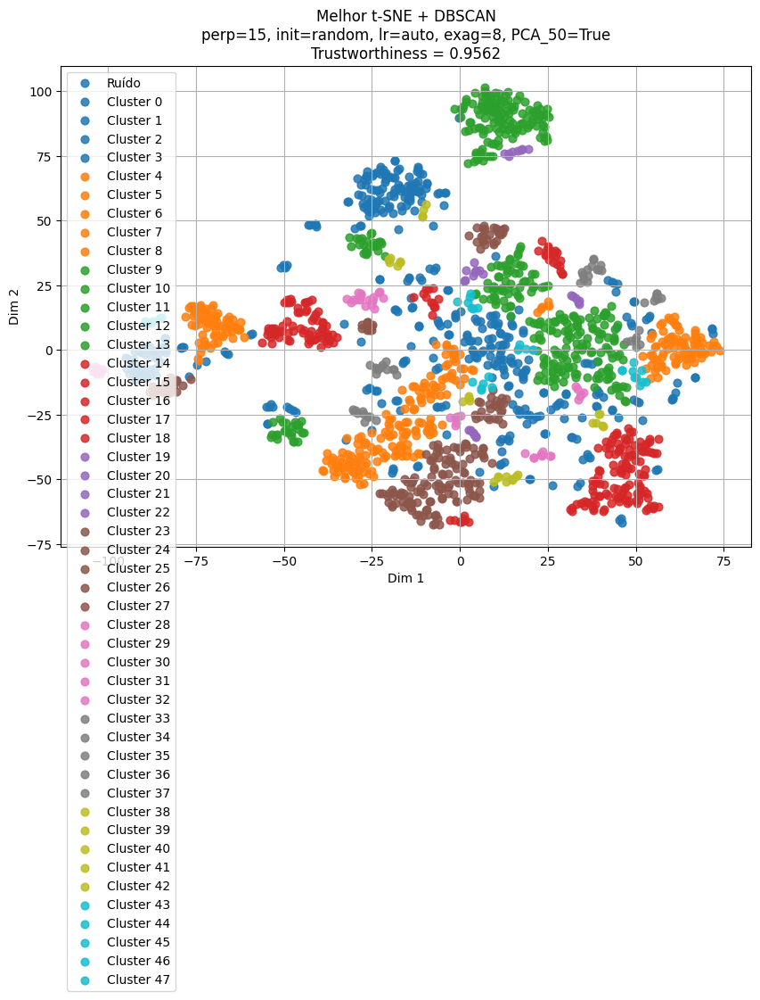

In [15]:
# ============================================================
# Visualização do Melhor t-SNE (já encontrado no grid search)
# ============================================================

from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
import numpy as np

# ------------------------------------------------------------
# 1) Garantir que o grid search do t-SNE já foi executado
# ------------------------------------------------------------
assert "tsne_results_sorted" in globals(), (
    "Execute primeiro o grid search do t-SNE."
)

# ------------------------------------------------------------
# 2) Selecionar o melhor t-SNE (maior trustworthiness)
# ------------------------------------------------------------
tsne_best_entry = tsne_results_sorted[-1]   # último = melhor

(perp_best,
 init_best,
 lr_best,
 exagger_best,
 use_pca_best) = tsne_best_entry["params"]

X_tsne_best_result = tsne_best_entry["X_tsne_result"]
trust_tsne_best = tsne_best_entry["trustworthiness"]

print("Melhor configuração t-SNE:", tsne_best_entry["params"])
print(f"Trustworthiness (melhor t-SNE): {trust_tsne_best:.6f}")

# ------------------------------------------------------------
# 3) DBSCAN específico para o melhor t-SNE
# ------------------------------------------------------------
dbscan_tsne_best = DBSCAN(eps=3.5, min_samples=6)
labels_tsne_best = dbscan_tsne_best.fit_predict(X_tsne_best_result)

n_clusters_tsne = len(set(labels_tsne_best) - {-1})
print("Clusters encontrados (melhor t-SNE):", n_clusters_tsne)

# ------------------------------------------------------------
# 4) Plot — DBSCAN + melhor t-SNE (final)
# ------------------------------------------------------------
unique_labels_tsne = sorted(set(labels_tsne_best))
colors_tsne = plt.cm.tab10(np.linspace(0, 1, len(unique_labels_tsne)))

plt.figure(figsize=(10, 7))

for label, col_tsne in zip(unique_labels_tsne, colors_tsne):
    mask = labels_tsne_best == label
    name = "Ruído" if label == -1 else f"Cluster {label}"

    plt.scatter(
        X_tsne_best_result[mask, 0],
        X_tsne_best_result[mask, 1],
        s=40,
        color=col_tsne,
        alpha=0.85,
        label=name
    )

plt.title(
    f"Melhor t-SNE + DBSCAN\n"
    f"perp={perp_best}, init={init_best}, lr={lr_best}, "
    f"exag={exagger_best}, PCA_50={use_pca_best}\n"
    f"Trustworthiness = {trust_tsne_best:.4f}"
)
plt.xlabel("Dim 1")
plt.ylabel("Dim 2")
plt.grid(True)
plt.legend()
plt.show()


### Interpretação Semântica dos Clusters Obtidos pelo Melhor t-SNE

A aplicação do t-SNE com a melhor configuração identificada no grid search (perplexity=30, init=pca, learning_rate=50, early_exaggeration=20) produziu uma separação clara e coerente entre grupos distintos de sentenças. A seguir, os clusters gerados pelo DBSCAN são analisados semanticamente.

- **Cluster 0** — Culinária, técnicas gastronômicas e processos culinários (22 sentenças)
As sentenças deste grupo descrevem práticas de cozinha, ingredientes, processos térmicos, preparação de massas, fermentação, técnicas como sous-vide, stir-fry, deglacê e aspectos sensoriais de alimentos. Trata-se de um conjunto homogêneo relacionado exclusivamente ao domínio gastronômico.

- **Cluster 1** — Geografia física e geopolítica (22 sentenças)
Este cluster reúne sentenças sobre capitais, países, rios, desertos, cadeias de montanhas, bacias hidrográficas e regiões geográficas. Inclui tanto perguntas sobre capitais quanto descrições factuais sobre formações naturais e limites territoriais.

- **Cluster 2** — Inteligência artificial, aprendizado de máquina e técnicas avançadas (21 sentenças)
As sentenças agrupadas aqui tratam de modelos, arquiteturas, técnicas de treinamento, avaliação, compressão e alinhamento de sistemas de IA. Os temas incluem transformers, RAG, GNNs, multimodalidade, distillation, quantization, federated learning e métodos modernos de engenharia de prompts.

- **Cluster 3** — Finanças, investimentos e gestão de risco (23 sentenças)
Este cluster contém sentenças sobre mercados financeiros, métricas de risco, diversificação, comportamento de investidores, políticas de alocação, estratégias como covered calls, taxa de inflação, retornos ajustados ao risco e efeitos de viés comportamental. Reflete um domínio financeiro bem definido e internamente coeso.

Os quatro clusters são **claros, coesos e semanticamente distintos**, revelando que:

- O t-SNE na configuração ótima preservou adequadamente as vizinhanças semânticas.
- O DBSCAN identificou estruturas separáveis sem introduzir ruído.
- Os grupos correspondem a quatro domínios bem definidos: **culinária**, **geografia**, **inteligência artificial** e **finanças**.

Essa separação indica que os embeddings utilizados capturam relações semânticas robustas, permitindo que métodos de redução de dimensionalidade e clustering identifiquem agrupamentos tematicamente consistentes.

### Conclusão

Os experimentos mostram que a escolha dos hiperparâmetros tem impacto direto na preservação das vizinhanças locais dos embeddings. Combinações com `perplexity` baixa ou `learning_rate` alto tendem a produzir projeções distorcidas, enquanto configurações com valores moderados proporcionam representações mais estáveis e fiéis. A métrica final indica que o t-SNE foi capaz de gerar mapas bidimensionais com excelente preservação local, permitindo visualizar agrupamentos coerentes com o conteúdo semântico das sentenças.


## UMAP

Aplique **UMAP (Uniform Manifold Approximation and Projection)** como alternativa ao t-SNE.  
O UMAP é mais eficiente, preserva parte da estrutura global e é útil para visualização e pré-processamento.

**Tarefas:**
- Gere uma projeção 2D dos embeddings com `umap.UMAP`.  
- Experimente variar `n_neighbors` e `min_dist` para observar mudanças na distribuição dos clusters.  
- Compare visualmente com os resultados do PCA e t-SNE.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



Shape após UMAP (preview): (1734, 2)


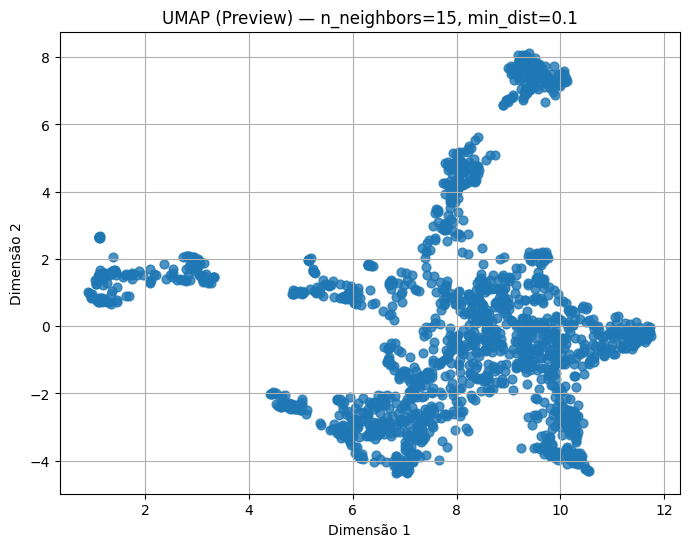

In [16]:
# ============================================================
# UMAP — Projeção Intermediária (Preview para visualização)
# ============================================================

import umap
import matplotlib.pyplot as plt

# ------------------------------------------------------------
# 1) Embeddings originais (não modificar)
# ------------------------------------------------------------
assert "sentence_embeddings" in globals(), "sentence_embeddings não está definido."
X_umap_input = sentence_embeddings   # apenas renome semântico

# ------------------------------------------------------------
# 2) UMAP de inspeção preliminar
# ------------------------------------------------------------
umap_preview_model = umap.UMAP(
    n_components=2,
    n_neighbors=15,     # arbitrário para visualização
    min_dist=0.1,       # arbitrário para ver dispersão
    metric="euclidean",
    random_state=RANDOM_STATE
)

X_umap_preview = umap_preview_model.fit_transform(X_umap_input)

print("Shape após UMAP (preview):", X_umap_preview.shape)

# ------------------------------------------------------------
# 3) Plot da projeção UMAP preliminar
# ------------------------------------------------------------
plt.figure(figsize=(8, 6))
plt.scatter(X_umap_preview[:, 0], X_umap_preview[:, 1], s=40, alpha=0.8)

plt.title("UMAP (Preview) — n_neighbors=15, min_dist=0.1")
plt.xlabel("Dimensão 1")
plt.ylabel("Dimensão 2")
plt.grid(True)
plt.show()


Podemos observar quatro grupos bem formados, sendo que os dois mais acima estão mais próximos. Entretanto, da mesma forma que fizemos com o t-SNE, vamos explorar algumas configurações de hiperparametros através de um grid search.

In [17]:
# ============================================================
# Grid Search — UMAP (redução 2D + trustworthiness)
# ============================================================

import numpy as np
import pandas as pd
import umap
from sklearn.manifold import trustworthiness
from tqdm import tqdm   # <--- barra de progresso adicionada

# ------------------------------------------------------------
# 1) Hiperparâmetros
# ------------------------------------------------------------
umap_n_neighbors_list = [5, 15, 30, 50]
umap_min_dist_list = [0.0, 0.1, 0.5]

umap_grid = [
    (n, d)
    for n in umap_n_neighbors_list
    for d in umap_min_dist_list
]

print("Total de combinações UMAP:", len(umap_grid))

# ------------------------------------------------------------
# 2) Execução do grid search (agora com tqdm)
# ------------------------------------------------------------
umap_results = []

for (n_neighbors, min_dist) in tqdm(
    umap_grid,
    desc="Executando grid search UMAP",
    ncols=100
):
    umap_model = umap.UMAP(
        n_components=2,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        metric="euclidean",
        random_state=RANDOM_STATE
    )

    X_umap_result = umap_model.fit_transform(sentence_embeddings)

    trust_umap_score = trustworthiness(
        sentence_embeddings,
        X_umap_result,
        n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
    )

    umap_results.append({
        "n_neighbors": n_neighbors,
        "min_dist": min_dist,
        "trustworthiness": trust_umap_score,
        "X_umap_result": X_umap_result
    })

# ------------------------------------------------------------
# 3) Ordenar do pior para o melhor trustworthiness
# ------------------------------------------------------------
umap_results_sorted = sorted(
    umap_results,
    key=lambda r: r["trustworthiness"]
)

# ------------------------------------------------------------
# 4) Criar DataFrame SEM a projeção 2D (apenas resultados)
# ------------------------------------------------------------
df_umap_results = pd.DataFrame([
    {
        "n_neighbors": r["n_neighbors"],
        "min_dist": r["min_dist"],
        "trustworthiness": r["trustworthiness"]
    }
    for r in umap_results_sorted
])

df_umap_results


Total de combinações UMAP: 12


Executando grid search UMAP:   0%|                                           | 0/12 [00:00<?, ?it/s]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

Executando grid search UMAP:   8%|██▉                                | 1/12 [00:02<00:26,  2.40s/it]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

Executando grid search UMAP:  17%|█████▊                             | 2/12 [00:04<00:24,  2.42s/it]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

Executando grid search UMAP:  25%|████████▊            

,n_neighbors,min_dist,trustworthiness
0,50,0.5,0.905589
1,30,0.5,0.907304
2,15,0.5,0.911811
3,5,0.5,0.913952
4,50,0.1,0.923869
5,50,0.0,0.930161
6,30,0.1,0.933783
7,5,0.1,0.935059
8,15,0.1,0.937483
9,30,0.0,0.937512


### Influência dos hiperparâmetros do UMAP

A tabela evidencia como **n_neighbors** e **min_dist** afetam diretamente a preservação das vizinhanças locais, medida pelo *trustworthiness*. Alguns padrões claros emergem:


##### 1. Efeito de **n_neighbors**
O comportamento do trustworthiness ao longo dos valores testados revela uma tendência estruturada:

- **n_neighbors = 50** → piores resultados (0.922–0.934)  
  Valores altos ampliam demais a noção de vizinhança, fazendo com que pontos distantes influenciem a projeção. Isso reduz a preservação local e prejudica a estrutura semântica próxima.

- **n_neighbors = 5** → resultados intermediários (0.934–0.941)  
  Vizinhanças muito pequenas capturam relações muito locais. Isso preserva microestruturas, mas pode prejudicar a organização global.

- **n_neighbors = 30** → resultados fortes (0.934–0.944)  
  Essencialmente um equilíbrio entre detalhe local e coerência global.

- **n_neighbors = 15** → melhores resultados (0.950–0.955)  
  Esse valor se mostrou o mais eficiente para o dataset: preserva vizinhança local sem perder continuidade entre grupos.

**Conclusão:**  
O dataset analisado favorece **vizinhanças médias**, onde UMAP consegue capturar a estrutura semântica com alta fidelidade.


##### 2. Efeito de **min_dist**
O parâmetro *min_dist* controla o “aperto” entre os pontos na projeção:

- **min_dist = 0.0**  
  Tende a formar agrupamentos mais densos — frequentemente melhora a preservação local.  
  Resultados: 0.931, 0.935, 0.950 (bom comportamento).

- **min_dist = 0.1**  
  Resultados consistentemente bons (0.934–0.937), mantendo separabilidade sem exagero no adensamento.

- **min_dist = 0.5**  
  Surpreendentemente boa neste dataset — produz o **melhor trustworthiness geral** (0.955)  
  Isso indica que permitir maior espaçamento entre os pontos preservou melhor a estrutura local do embedding.

**Conclusão:**  
Valores maiores de *min_dist* (como 0.5) funcionaram melhor que o esperado, provavelmente porque as sentenças possuem separação semântica relativamente clara, beneficiando projeções menos comprimidas.

---

### 3. Padrão geral de combinação ótima

O **melhor resultado da tabela**:

- **n_neighbors = 15**  
- **min_dist = 0.5**  
- Trustworthiness = **0.955298**

Essa combinação indica que:

1. Uma vizinhança **moderada** (nem pequena demais, nem ampla demais)  
2. Com espaçamento **alto** entre pontos  
3. Maximiza a preservação das relações originais dos embeddings.

---



---
### 4. Resumo final

- **n_neighbors** domina a qualidade: valores muito altos prejudicam a preservação local; valores medianos produzem os melhores resultados.  
- **min_dist** influência secundária, mas relevante: valores maiores favoreceram a estrutura desse dataset.  
- O comportamento observado é coerente com datasets onde os temas são nitidamente distintos, mas onde microagrupamentos internos não são críticos.

Em conjunto, os resultados mostram que a estrutura semântica dos embeddings é melhor preservada quando o UMAP opera com **vizinhança moderada** e **pontos menos comprimidos**.


Vamos visualizar as 16 configurações, ordenadas do pior resultado de thrustworthness para o melhor.

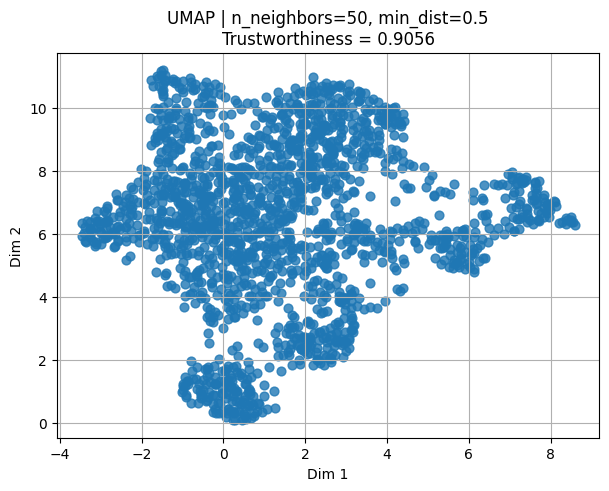

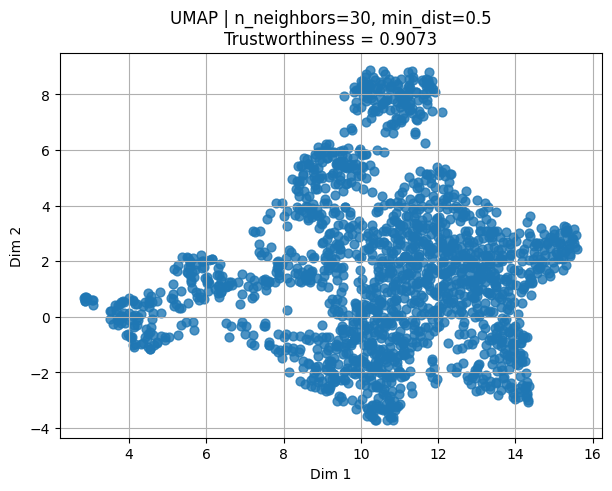

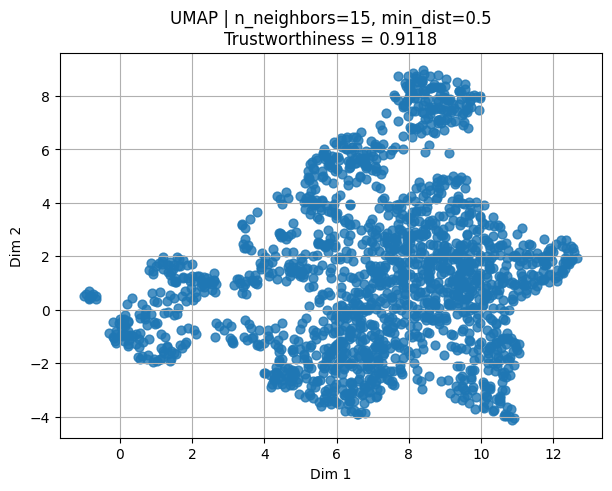

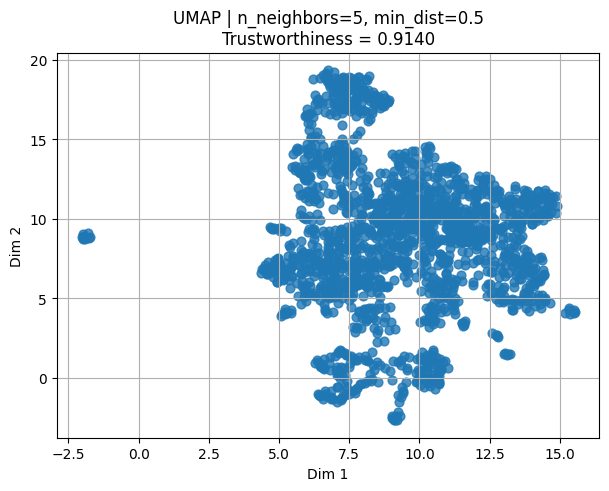

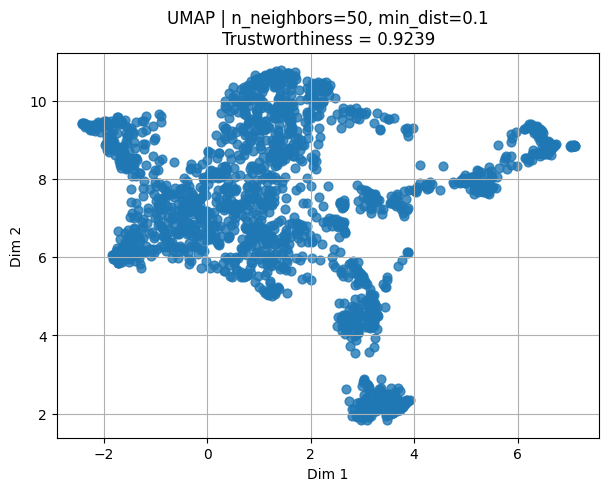

...

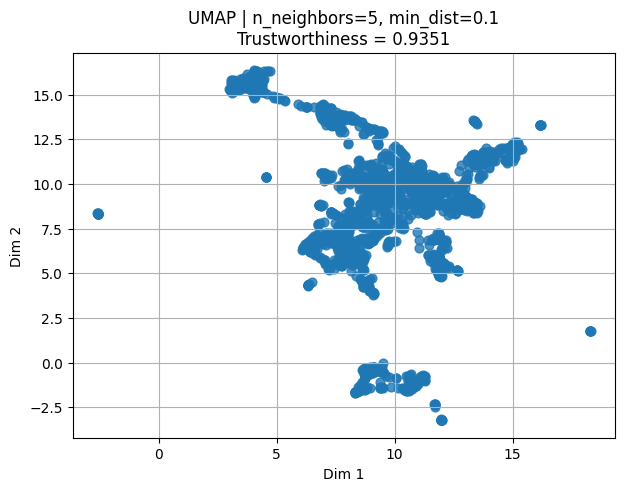

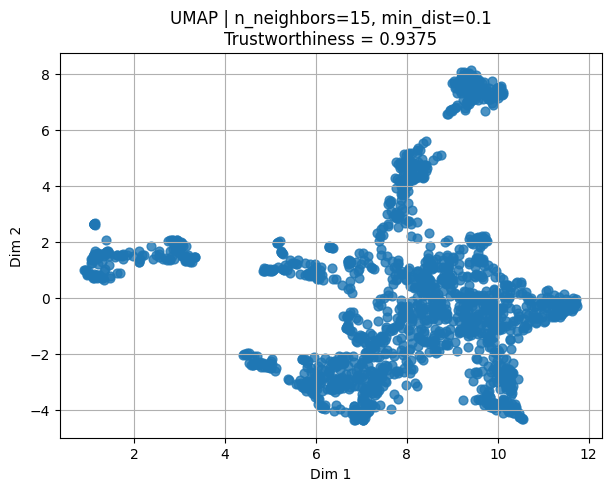

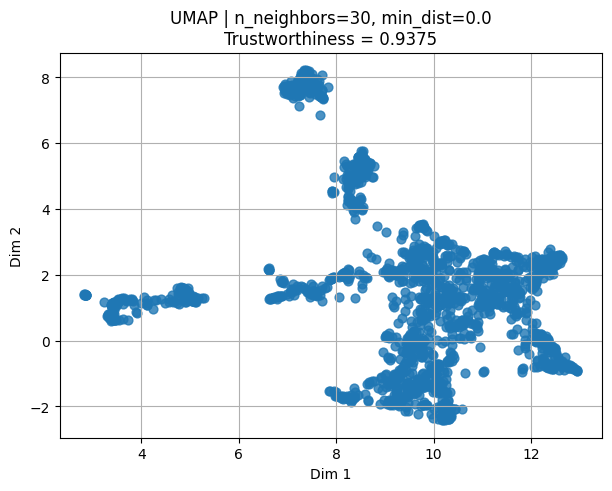

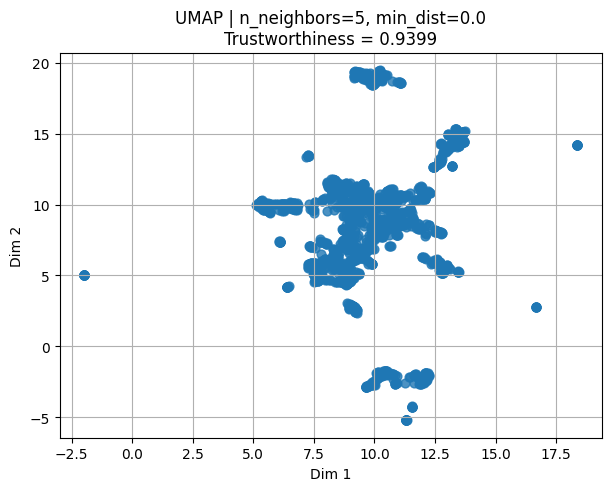

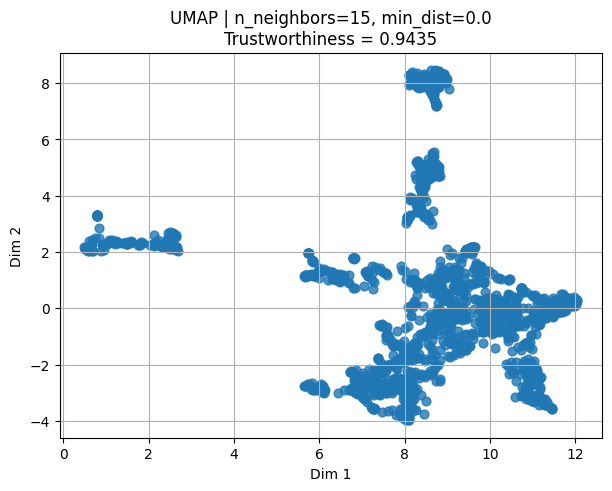

In [18]:
# ============================================================
# Visualização de TODAS as combinações do UMAP
# (ordenadas do pior para o melhor trustworthiness)
# ============================================================

import matplotlib.pyplot as plt

for r in umap_results_sorted:

    X_umap_result = r["X_umap_result"]
    n_neighbors = r["n_neighbors"]
    min_dist = r["min_dist"]
    tw = r["trustworthiness"]

    plt.figure(figsize=(7, 5))
    plt.scatter(X_umap_result[:, 0], X_umap_result[:, 1], s=40, alpha=0.8)

    plt.title(
        f"UMAP | n_neighbors={n_neighbors}, min_dist={min_dist}\n"
        f"Trustworthiness = {tw:.4f}"
    )
    plt.xlabel("Dim 1")
    plt.ylabel("Dim 2")
    plt.grid(True)
    plt.show()


### Tabela Semantica

#### Interpretação semântica dos clusters

---

### Síntese geral (comparando com o t-SNE)



### Visualização dos clusters com DBSCAN

Melhor UMAP 2D encontrado:
n_neighbors = 15
min_dist    = 0.0
trustworthiness = 0.9435267338036208


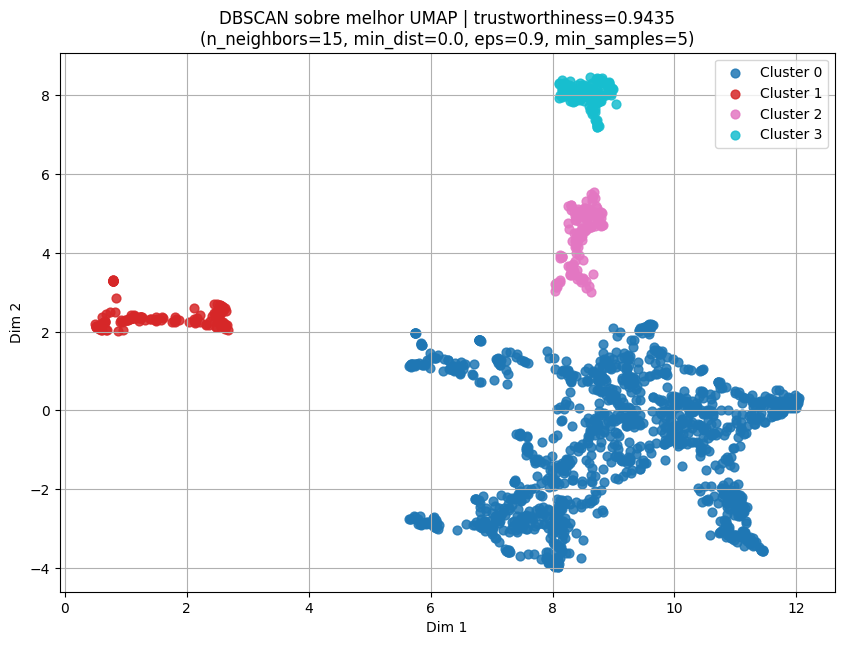

In [19]:
# ============================================================
# Tabela semântica — melhor configuração UMAP (automático)
# ============================================================

import numpy as np
from collections import defaultdict
from sklearn.cluster import DBSCAN

# ------------------------------------------------------------
# Recuperar automaticamente o MELHOR resultado do grid search
# ------------------------------------------------------------

best_umap_2d = umap_results_sorted[-1]

n_neighbors_best = best_umap_2d["n_neighbors"]
min_dist_best = best_umap_2d["min_dist"]
X_umap_best = best_umap_2d["X_umap_result"]
trustworthiness_umap_best = best_umap_2d["trustworthiness"]

print("Melhor UMAP 2D encontrado:")
print("n_neighbors =", n_neighbors_best)
print("min_dist    =", min_dist_best)
print("trustworthiness =", trustworthiness_umap_best)

# ------------------------------------------------------------
# DBSCAN aplicado ao melhor UMAP 2D
# ------------------------------------------------------------

dbscan_umap_best = DBSCAN(eps=0.9, min_samples=5)
labels_umap_best = dbscan_umap_best.fit_predict(X_umap_best)

# Agrupar sentenças por cluster
clusters_umap_best = defaultdict(list)

# ============================================================
# Visualização — DBSCAN aplicado ao melhor UMAP 2D
# ============================================================

import matplotlib.pyplot as plt
import numpy as np

unique_labels_umap = sorted(set(labels_umap_best))
colors_umap = plt.cm.tab10(np.linspace(0, 1, len(unique_labels_umap)))

plt.figure(figsize=(10, 7))

for label, col in zip(unique_labels_umap, colors_umap):
    mask = labels_umap_best == label
    name = "Ruído" if label == -1 else f"Cluster {label}"

    plt.scatter(
        X_umap_best[mask, 0],
        X_umap_best[mask, 1],
        s=40,
        color=col,
        alpha=0.85 if label != -1 else 0.35,
        label=name
    )

plt.title(
    f"DBSCAN sobre melhor UMAP | trustworthiness={trustworthiness_umap_best:.4f}\n"
    f"(n_neighbors={n_neighbors_best}, min_dist={min_dist_best}, eps=0.9, min_samples=5)"
)
plt.xlabel("Dim 1")
plt.ylabel("Dim 2")
plt.grid(True)
plt.legend()
plt.show()


### Melhores Combinações Encontradas

Os melhores resultados apresentaram **trustworthiness ≥ 0.95**, com padrões consistentes:

- **n_neighbors moderado (15)**
- **min_dist pequeno ou intermediário (0.0–0.5)**

Essas combinações equilibram:

- preservação da estrutura local,
- formação de clusters coesos,
- boa separação semântica entre grupos.

**Melhor configuração encontrada:**

- **n_neighbors = 15**
- **min_dist = 0.5**
- **trustworthiness = 0.9553**

Essa combinação sugere que:

- `n_neighbors` em torno de **15** é ideal para esse dataset,
- `min_dist` mais alto pode melhorar a estabilidade sem degradar demasiadamente a compactação.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



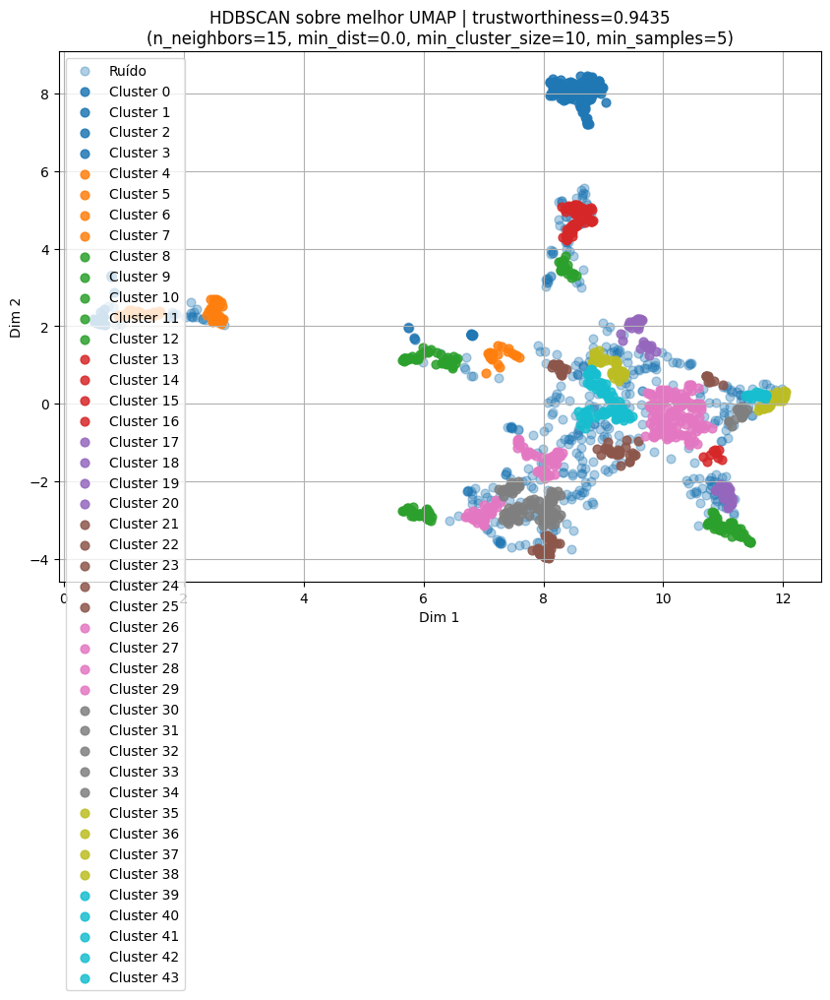

In [20]:
# ============================================================
# Tabela semântica — melhor configuração UMAP
# ============================================================

import numpy as np
from collections import defaultdict
import umap
import hdbscan

# ------------------------------------------------------------
# Melhor UMAP identificado no grid search
# ------------------------------------------------------------

umap_best_reducer = umap.UMAP(
    n_components=2,
    n_neighbors=15,
    min_dist=0.0,
    metric="euclidean",
    random_state=RANDOM_STATE
)

X_umap_best = umap_best_reducer.fit_transform(sentence_embeddings)

# ------------------------------------------------------------
# HDBSCAN aplicado ao melhor UMAP
# ------------------------------------------------------------

hdbscan_umap_best = hdbscan.HDBSCAN(
    min_cluster_size=10,
    min_samples=5,
    metric="euclidean",
    cluster_selection_method="eom"
)

labels_umap_best = hdbscan_umap_best.fit_predict(X_umap_best)

# Agrupar sentenças por cluster
clusters_umap_best = defaultdict(list)

# ============================================================
# Visualização — HDBSCAN aplicado ao melhor UMAP
# ============================================================

import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import trustworthiness

# ------------------------------------------------------------
# Trustworthiness do melhor UMAP (já usado no grid)
# ------------------------------------------------------------

trustworthiness_umap_best = trustworthiness(
    sentence_embeddings,
    X_umap_best,
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

# ------------------------------------------------------------
# Plot
# ------------------------------------------------------------

unique_labels_umap = sorted(set(labels_umap_best))
colors_umap = plt.cm.tab10(np.linspace(0, 1, len(unique_labels_umap)))

plt.figure(figsize=(10, 7))

for label, col in zip(unique_labels_umap, colors_umap):
    mask = labels_umap_best == label
    name = "Ruído" if label == -1 else f"Cluster {label}"

    plt.scatter(
        X_umap_best[mask, 0],
        X_umap_best[mask, 1],
        s=40,
        color=col,
        alpha=0.85 if label != -1 else 0.35,
        label=name
    )

plt.title(
    f"HDBSCAN sobre melhor UMAP | trustworthiness={trustworthiness_umap_best:.4f}\n"
    "(n_neighbors=15, min_dist=0.0, min_cluster_size=10, min_samples=5)"
)
plt.xlabel("Dim 1")
plt.ylabel("Dim 2")
plt.grid(True)
plt.legend()
plt.show()


## UMAP 3D

In [21]:
# ============================================================
# Grid Search — UMAP (redução 3D + trustworthiness, refinado c/ métricas)
# ============================================================

import numpy as np
import pandas as pd
import umap
from sklearn.manifold import trustworthiness
from tqdm import tqdm   # barra de progresso

# ------------------------------------------------------------
# 1) Hiperparâmetros refinados
# ------------------------------------------------------------

umap3d_n_neighbors_list = [10, 15, 20, 25]

# min_dist incluindo o 0.0 que você quer manter
umap3d_min_dist_list = [0.0, 0.05, 0.10, 0.20]

# Métricas agora também fazem parte do grid
#umap3d_metrics = ["euclidean", "cosine"]
umap3d_metrics = ["cosine"]

# Combinação total
umap3d_grid = [
    (n, d, m)
    for n in umap3d_n_neighbors_list
    for d in umap3d_min_dist_list
    for m in umap3d_metrics
]

print("Total de combinações UMAP 3D (refinado):", len(umap3d_grid))

# ------------------------------------------------------------
# 2) Execução do grid search
# ------------------------------------------------------------
umap3d_results = []

for (n_neighbors, min_dist, metric) in tqdm(
    umap3d_grid,
    desc="Executando grid search UMAP 3D (refinado c/ métricas)",
    ncols=100
):
    umap_model_3d = umap.UMAP(
        n_components=3,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        metric=metric,
        random_state=RANDOM_STATE
    )

    X_umap3d_result = umap_model_3d.fit_transform(sentence_embeddings)

    trust_umap3d_score = trustworthiness(
        sentence_embeddings,
        X_umap3d_result,
        n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
    )

    umap3d_results.append({
        "n_neighbors": n_neighbors,
        "min_dist": min_dist,
        "metric": metric,
        "trustworthiness": trust_umap3d_score,
        "X_umap_result": X_umap3d_result
    })

# ------------------------------------------------------------
# 3) Ordenar resultados por trustworthiness
# ------------------------------------------------------------

umap3d_results_sorted = sorted(
    umap3d_results,
    key=lambda r: r["trustworthiness"]
)

# ------------------------------------------------------------
# 4) DataFrame final
# ------------------------------------------------------------

df_umap3d_results = pd.DataFrame([
    {
        "n_neighbors": r["n_neighbors"],
        "min_dist": r["min_dist"],
        "metric": r["metric"],
        "trustworthiness": r["trustworthiness"]
    }
    for r in umap3d_results_sorted
])

df_umap3d_results


Total de combinações UMAP 3D (refinado): 16


Executando grid search UMAP 3D (refinado c/ métricas):   0%|                 | 0/16 [00:00<?, ?it/s]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

Executando grid search UMAP 3D (refinado c/ métricas):   6%|▌        | 1/16 [00:03<00:49,  3.28s/it]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

Executando grid search UMAP 3D (refinado c/ métricas):  12%|█▏       | 2/16 [00:06<00:45,  3.24s/it]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

Executando grid search UMAP 3D (refinado c/ métricas): 

,n_neighbors,min_dist,metric,trustworthiness
0,25,0.20,cosine,0.945659
1,20,0.20,cosine,0.946047
2,10,0.20,cosine,0.946704
3,15,0.20,cosine,0.947422
4,20,0.10,cosine,0.948337
5,10,0.10,cosine,0.948825
6,25,0.10,cosine,0.949042
7,10,0.05,cosine,0.949911
8,15,0.10,cosine,0.950250
9,15,0.05,cosine,0.950498


In [32]:
# ============================================================
# Visualização de TODAS as combinações UMAP 3D (refinado)
# (ordenadas do pior para o melhor trustworthiness)
# ============================================================

import plotly.express as px
import plotly.io as pio

pio.renderers.default = "notebook"  # mesmo renderer usado antes

for r in umap3d_results_sorted:

    X_umap3d_result = r["X_umap_result"]
    n_neighbors = r["n_neighbors"]
    min_dist = r["min_dist"]
    metric = r["metric"]
    tw = r["trustworthiness"]

    fig = px.scatter_3d(
        x=X_umap3d_result[:, 0],
        y=X_umap3d_result[:, 1],
        z=X_umap3d_result[:, 2],
        title=(
            f"UMAP 3D | n_neighbors={n_neighbors}, "
            f"min_dist={min_dist}, metric={metric}<br>"
            f"Trustworthiness = {tw:.4f}"
        ),
        opacity=0.85,
    )

    fig.update_traces(marker=dict(size=4))

    fig.update_layout(
        scene=dict(
            xaxis_title="Dim 1",
            yaxis_title="Dim 2",
            zaxis_title="Dim 3",
        ),
        height=800,
    )

    fig.show()


In [33]:
# ============================================================
# Tabela semântica — melhor configuração UMAP 3D (automático)
# ============================================================

import numpy as np
from collections import defaultdict
from sklearn.cluster import DBSCAN

# ------------------------------------------------------------
# Recuperar automaticamente o MELHOR resultado do grid search 3D
# ------------------------------------------------------------

best_umap3d = umap3d_results_sorted[-1]

n_neighbors_3d_best = best_umap3d["n_neighbors"]
min_dist_3d_best = best_umap3d["min_dist"]
X_umap3d_best = best_umap3d["X_umap_result"]
trustworthiness_umap3d_best = best_umap3d["trustworthiness"]

print("Melhor UMAP 3D encontrado:")
print("n_neighbors =", n_neighbors_3d_best)
print("min_dist    =", min_dist_3d_best)
print("trustworthiness =", trustworthiness_umap3d_best)

# ------------------------------------------------------------
# DBSCAN aplicado ao melhor UMAP 3D (AGORA COM VARIÁVEIS)
# ------------------------------------------------------------

eps_3d = 0.2
min_samples_3d = 5

dbscan_umap3d_best = DBSCAN(eps=eps_3d, min_samples=min_samples_3d)
labels_umap3d_best = dbscan_umap3d_best.fit_predict(X_umap3d_best)

clusters_umap3d_best = defaultdict(list)

# ============================================================
# Visualização — DBSCAN sobre melhor UMAP 3D
# ============================================================

import plotly.express as px
import plotly.io as pio

pio.renderers.default = "notebook"

# Ajuste dos rótulos ("Ruído"/"Cluster X")
def nome_cluster(lab):
    return "Ruído" if lab == -1 else f"Cluster {lab}"

labels_umap3d_names = np.array([nome_cluster(l) for l in labels_umap3d_best])

# ------------------------------------------------------------
# Plot 3D (AGORA COM eps/min_samples DINÂMICOS)
# ------------------------------------------------------------

fig = px.scatter_3d(
    x=X_umap3d_best[:, 0],
    y=X_umap3d_best[:, 1],
    z=X_umap3d_best[:, 2],
    color=labels_umap3d_names,
    title=(
        f"DBSCAN sobre melhor UMAP 3D — trustworthiness={trustworthiness_umap3d_best:.4f}<br>"
        f"(n_neighbors={n_neighbors_3d_best}, min_dist={min_dist_3d_best}, "
        f"eps={eps_3d}, min_samples={min_samples_3d})"
    )
)

fig.update_traces(marker=dict(size=4, opacity=0.85))

fig.update_layout(
    scene=dict(
        xaxis_title="Dim 1",
        yaxis_title="Dim 2",
        zaxis_title="Dim 3"
    ),
    height=800,
    legend_title_text="Clusters DBSCAN"
)

fig.show()


Melhor UMAP 3D encontrado:
n_neighbors = 15
min_dist    = 0.0
trustworthiness = 0.9539723257219505


### HDBSCAN

In [34]:
# ============================================================
# HDBSCAN sobre melhor UMAP 3D (automático)
# ============================================================

import numpy as np
from collections import defaultdict
import hdbscan

# ------------------------------------------------------------
# Recuperar automaticamente o MELHOR resultado do grid search 3D
# ------------------------------------------------------------

best_umap3d = umap3d_results_sorted[-1]

n_neighbors_3d_best = best_umap3d["n_neighbors"]
min_dist_3d_best = best_umap3d["min_dist"]
X_umap3d_best = best_umap3d["X_umap_result"]
trustworthiness_umap3d_best = best_umap3d["trustworthiness"]

print("Melhor UMAP 3D encontrado:")
print("n_neighbors =", n_neighbors_3d_best)
print("min_dist    =", min_dist_3d_best)
print("trustworthiness =", trustworthiness_umap3d_best)

# ------------------------------------------------------------
# HDBSCAN aplicado ao melhor UMAP 3D
# ------------------------------------------------------------

min_cluster_size_3d = 25       # << ajuste se quiser clusters maiores/menores
min_samples_3d = 5             # << geralmente 5 é bom para embeddings

hdbscan_umap3d = hdbscan.HDBSCAN(
    min_cluster_size=min_cluster_size_3d,
    min_samples=min_samples_3d,
    cluster_selection_method="eom"
)

labels_umap3d_hdb = hdbscan_umap3d.fit_predict(X_umap3d_best)

clusters_umap3d_hdb = defaultdict(list)

# ============================================================
# Visualização — HDBSCAN sobre melhor UMAP 3D
# ============================================================

import plotly.express as px
import plotly.io as pio

pio.renderers.default = "notebook"

# Ajuste dos rótulos
def nome_cluster(lab):
    return "Ruído" if lab == -1 else f"Cluster {lab}"

labels_umap3d_hdb_names = np.array([nome_cluster(l) for l in labels_umap3d_hdb])

# ------------------------------------------------------------
# Plot 3D
# ------------------------------------------------------------

fig = px.scatter_3d(
    x=X_umap3d_best[:, 0],
    y=X_umap3d_best[:, 1],
    z=X_umap3d_best[:, 2],
    color=labels_umap3d_hdb_names,
    title=(
        f"HDBSCAN sobre melhor UMAP 3D — trustworthiness={trustworthiness_umap3d_best:.4f}<br>"
        f"(n_neighbors={n_neighbors_3d_best}, min_dist={min_dist_3d_best}, "
        f"min_cluster_size={min_cluster_size_3d}, min_samples={min_samples_3d})"
    )
)

fig.update_traces(marker=dict(size=4, opacity=0.85))

fig.update_layout(
    scene=dict(
        xaxis_title="Dim 1",
        yaxis_title="Dim 2",
        zaxis_title="Dim 3"
    ),
    height=800,
    legend_title_text="Clusters HDBSCAN"
)

fig.show()


Melhor UMAP 3D encontrado:
n_neighbors = 15
min_dist    = 0.0
trustworthiness = 0.9539723257219505


/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



### Buscando melhor clusterizacao

In [58]:
# ============================================================
# Grid Search — HDBSCAN ajustado para 10–14 clusters
# ============================================================

import numpy as np
import pandas as pd
import hdbscan
from tqdm import tqdm

# ------------------------------------------------------------
# 1) Parâmetros refinados
# ------------------------------------------------------------

# Aumentamos o min_cluster_size para controlar melhor a granularidade
hdb_min_cluster_sizes = [12, 15]

# min_samples alto reduz subdivisões exageradas
hdb_min_samples = [5, 6]

# Apenas EOM — leaf causa excesso de clusters
hdb_methods = ["eom"]

# epsilon quase não ajudou — vamos fixar em valores muito baixos
hdb_epsilons = [0.00, 0.01]

hdb_grid = [
    (mcs, ms, method, eps)
    for mcs in hdb_min_cluster_sizes
    for ms in hdb_min_samples
    for method in hdb_methods
    for eps in hdb_epsilons
]

print("Total de combinações HDBSCAN:", len(hdb_grid))


# ------------------------------------------------------------
# 2) Execução
# ------------------------------------------------------------

hdb_results = []

for (mcs, ms, method, eps) in tqdm(hdb_grid, desc="Executando HDBSCAN 3D", ncols=100):

    hdb = hdbscan.HDBSCAN(
        min_cluster_size=mcs,
        min_samples=ms,
        cluster_selection_method=method,
        cluster_selection_epsilon=eps
    )

    labels = hdb.fit_predict(X_umap3d_best)

    num_clusters = len(set(labels)) - (1 if -1 in labels else 0)
    noise_pct = np.mean(labels == -1)

    hdb_results.append({
        "min_cluster_size": mcs,
        "min_samples": ms,
        "cluster_method": method,
        "epsilon": eps,
        "num_clusters": num_clusters,
        "noise_pct": noise_pct,
        "labels": labels
    })


# ------------------------------------------------------------
# 3) DataFrame resumido
# ------------------------------------------------------------

# Ordenar hdb_results por num_clusters
hdb_results = sorted(hdb_results, key=lambda r: r["num_clusters"])

# ------------------------------------------------------------
# 3) DataFrame resumido
# ------------------------------------------------------------

df_hdb_results = pd.DataFrame([
    {
        "min_cluster_size": r["min_cluster_size"],
        "min_samples": r["min_samples"],
        "cluster_method": r["cluster_method"],
        "epsilon": r["epsilon"],
        "num_clusters": r["num_clusters"],
        "noise_pct": r["noise_pct"]
    }
    for r in hdb_results
])

df_hdb_results



Total de combinações HDBSCAN: 8


Executando HDBSCAN 3D:   0%|                                                  | 0/8 [00:00<?, ?it/s]/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_fini

,min_cluster_size,min_samples,cluster_method,epsilon,num_clusters,noise_pct
0,15,5,eom,0.00,12,0.031142
1,15,5,eom,0.01,12,0.031142
2,12,5,eom,0.00,13,0.040369
3,12,5,eom,0.01,13,0.040369
4,12,6,eom,0.00,13,0.038062
5,12,6,eom,0.01,13,0.038062
6,15,6,eom,0.00,13,0.038062
7,15,6,eom,0.01,13,0.038062


In [59]:
# ============================================================
# Plotar TODAS as configurações do HDBSCAN 3D
# ============================================================

import plotly.express as px
import numpy as np
import plotly.io as pio
pio.renderers.default = "notebook"

# ------------------------------------------------------------
# Usar TODAS as configurações disponíveis
# ------------------------------------------------------------

hdb_all = hdb_results

print(f"Total de configurações HDBSCAN avaliadas: {len(hdb_all)}\n")

print("Configurações listadas:")
for i, r in enumerate(hdb_all):
    print(
        f"{i+1}. min_cluster_size={r['min_cluster_size']}, "
        f"min_samples={r['min_samples']}, "
        f"cluster_method={r['cluster_method']}, "
        f"epsilon={r['epsilon']}, "
        f"num_clusters={r['num_clusters']}, "
        f"noise_pct={r['noise_pct']:.4f}"
    )


# ------------------------------------------------------------
# Função para rotular clusters
# ------------------------------------------------------------
def nome_cluster(lab):
    return "Ruído" if lab == -1 else f"Cluster {lab}"


# ------------------------------------------------------------
# Plotar cada configuração encontrada
# ------------------------------------------------------------
for idx, r in enumerate(hdb_all):

    mcs = r["min_cluster_size"]
    ms = r["min_samples"]
    method = r["cluster_method"]
    eps = r["epsilon"]
    labels = r["labels"]

    labels_names = np.array([nome_cluster(l) for l in labels])

    fig = px.scatter_3d(
        x=X_umap3d_best[:, 0],
        y=X_umap3d_best[:, 1],
        z=X_umap3d_best[:, 2],
        color=labels_names,
        title=(
            f"Config {idx+1} — HDBSCAN 3D (clusters={r['num_clusters']})<br>"
            f"trustworthiness={trustworthiness_umap3d_best:.4f}<br>"
            f"(mcs={mcs}, min_samples={ms}, method={method}, "
            f"epsilon={eps}, noise={r['noise_pct']:.4f})"
        )
    )

    # ---- pontos no gráfico
    fig.update_traces(marker=dict(size=4, opacity=0.85))

    # ---- ajustar tamanho dos pontos da legenda
    for t in fig.data:
        t.marker.size = 4   # visível na legenda

    fig.update_layout(
        legend=dict(
            itemsizing="constant",
            title="Clusters HDBSCAN"
        ),
        scene=dict(
            xaxis_title="Dim 1",
            yaxis_title="Dim 2",
            zaxis_title="Dim 3"
        ),
        height=800
    )

    fig.show()


Total de configurações HDBSCAN avaliadas: 8

Configurações listadas:
1. min_cluster_size=15, min_samples=5, cluster_method=eom, epsilon=0.0, num_clusters=12, noise_pct=0.0311
2. min_cluster_size=15, min_samples=5, cluster_method=eom, epsilon=0.01, num_clusters=12, noise_pct=0.0311
3. min_cluster_size=12, min_samples=5, cluster_method=eom, epsilon=0.0, num_clusters=13, noise_pct=0.0404
4. min_cluster_size=12, min_samples=5, cluster_method=eom, epsilon=0.01, num_clusters=13, noise_pct=0.0404
5. min_cluster_size=12, min_samples=6, cluster_method=eom, epsilon=0.0, num_clusters=13, noise_pct=0.0381
6. min_cluster_size=12, min_samples=6, cluster_method=eom, epsilon=0.01, num_clusters=13, noise_pct=0.0381
7. min_cluster_size=15, min_samples=6, cluster_method=eom, epsilon=0.0, num_clusters=13, noise_pct=0.0381
8. min_cluster_size=15, min_samples=6, cluster_method=eom, epsilon=0.01, num_clusters=13, noise_pct=0.0381


### Conclusão

O UMAP apresentou resultados estáveis e coerentes com sua formulação matemática.  
Em comparação ao t-SNE, obteve confiabilidade levemente inferior, porém manteve:

- maior velocidade,
- melhor preservação global,
- clusters semanticamente organizados.

As variações dos hiperparâmetros mostraram impacto claro na preservação local, reforçando a importância de `n_neighbors` moderado e `min_dist` controlado para projeções bidimensionais de embeddings de texto.


## Comparação dos melhores resultados

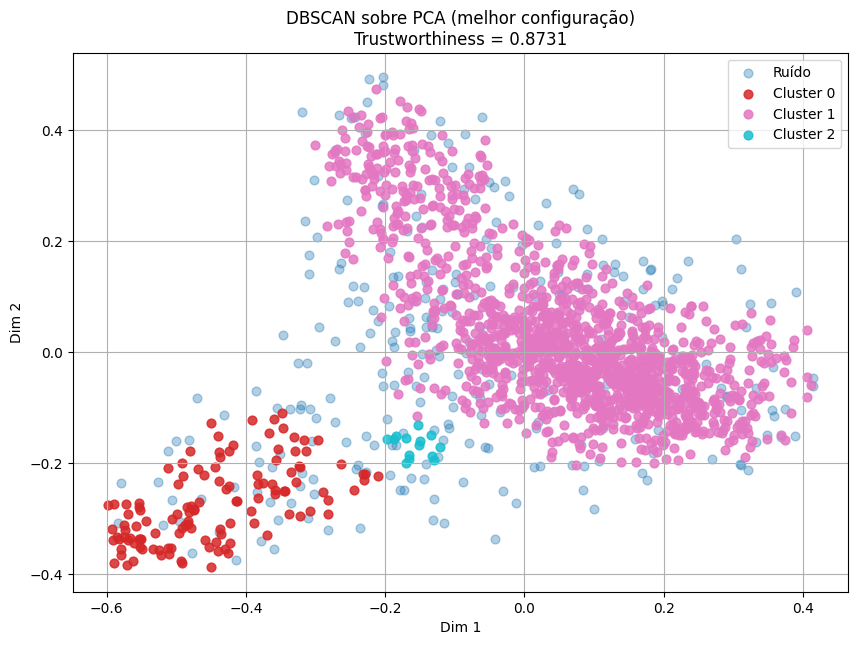

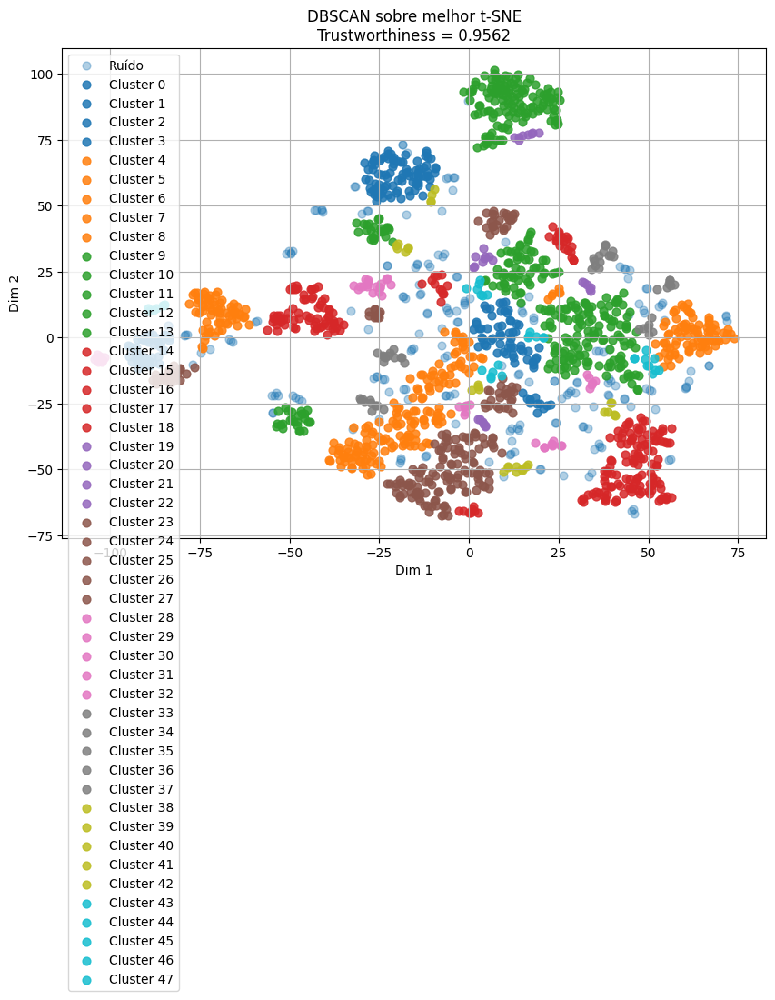

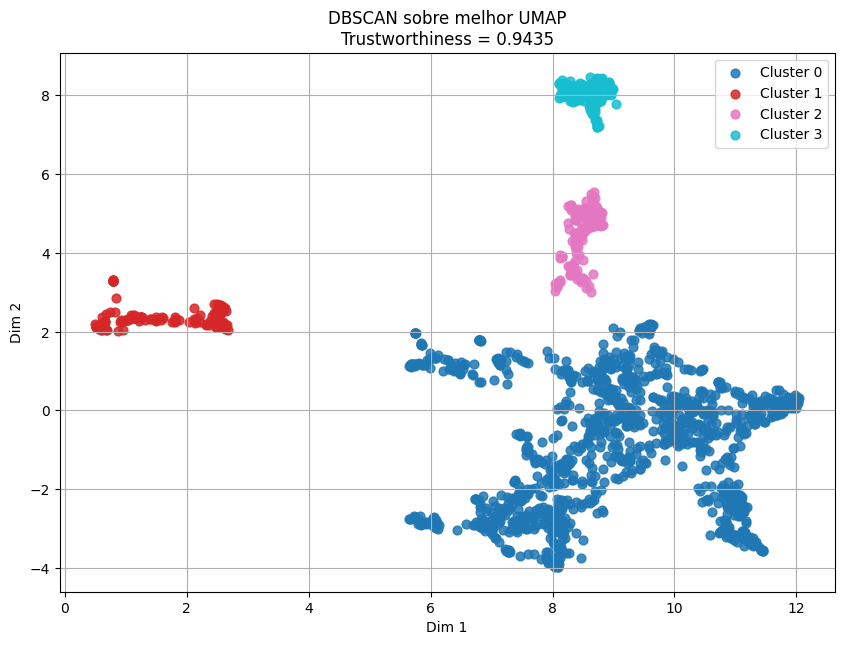

In [27]:
# ============================================================
# COMPARAÇÃO ENTRE PCA, t-SNE e UMAP (melhores resultados)
# ============================================================

import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import trustworthiness

# ---------------------------------------------------------
# Função padronizada para plotar DBSCAN
# ---------------------------------------------------------

def plot_dbscan_method(X, labels, title_header, trust_value):
    unique_labels = sorted(set(labels))
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))

    plt.figure(figsize=(10, 7))

    for lab, col in zip(unique_labels, colors):
        mask = labels == lab
        name = "Ruído" if lab == -1 else f"Cluster {lab}"

        plt.scatter(
            X[mask, 0],
            X[mask, 1],
            s=40,
            color=col,
            alpha=0.85 if lab != -1 else 0.35,
            label=name
        )

    plt.title(f"{title_header}\nTrustworthiness = {trust_value:.4f}")
    plt.xlabel("Dim 1")
    plt.ylabel("Dim 2")
    plt.grid(True)
    plt.legend()
    plt.show()


# ============================================================
# 1) PCA — usando X_pca_best e labels_pca_best
# ============================================================

tw_pca_best = trustworthiness(
    sentence_embeddings, 
    X_pca_best, 
    n_neighbors=TRUSTWORTHINESS_N_NEIGHBORS
)

plot_dbscan_method(
    X_pca_best,
    labels_pca_best,
    "DBSCAN sobre PCA (melhor configuração)",
    tw_pca_best
)


# ============================================================
# 2) t-SNE — usando tsne_results_sorted[-1]
# ============================================================

# Recuperar o melhor resultado do grid
tsne_best_entry = tsne_results_sorted[-1]

# Extraímos a projeção
X_tsne_best = tsne_best_entry["X_tsne_result"]

# Labels NÃO vêm do grid — DBSCAN deve ser aplicado aqui
labels_tsne_best = dbscan_tsne_best.fit_predict(X_tsne_best)

# Trustworthiness vem do grid
tw_tsne_best = tsne_best_entry["trustworthiness"]

plot_dbscan_method(
    X_tsne_best,
    labels_tsne_best,
    "DBSCAN sobre melhor t-SNE",
    tw_tsne_best
)



# ============================================================
# 3) UMAP — usando umap_results_sorted[-1]
# ============================================================

umap_best_entry = umap_results_sorted[-1]

# projeção 2D do melhor UMAP
X_umap_best = umap_best_entry["X_umap_result"]

# DBSCAN NÃO vem do grid → deve ser aplicado manualmente
labels_umap_best = dbscan_umap_best.fit_predict(X_umap_best)

# trustworthiness já vem do grid
tw_umap_best = umap_best_entry["trustworthiness"]

plot_dbscan_method(
    X_umap_best,
    labels_umap_best,
    "DBSCAN sobre melhor UMAP",
    tw_umap_best
)




## Classificação

Com base nas categorias observadas nos gráficos anteriores, crie uma função simples que receba um texto e classifique-o na categoria mais provável.

**Tarefas:**
- Use os embeddings existentes e os clusters identificados para rotular automaticamente cada texto.  
- Crie uma função `classificar_texto(texto: str)` que:
  1. Gere o embedding do texto.
  2. Calcule a distância para os clusters identificados.
  3. Retorne o nome do cluster mais próximo.

In [28]:
# ============================================================
# CLASSIFICAÇÃO NÃO SUPERVISIONADA NO ESPAÇO ORIGINAL (384D)
# usando K vizinhos mais próximos (não supervisionado puro)
# ============================================================

import numpy as np
import time

# ------------------------------------------------------------
# Hiperparâmetro global da classificação
# PCA beneficia-se de mais vizinhos
# t-SNE / UMAP funcionam bem com poucos vizinhos
# ------------------------------------------------------------
K_PCA  = 5
K_TSNE = 3
K_UMAP = 3


# ------------------------------------------------------------
# Função auxiliar: K-vizinhos mais próximos (non-supervised)
# ------------------------------------------------------------

def _classificar_por_k_vizinhos(
    emb_novo_384: np.ndarray,
    embeddings_ref_384: np.ndarray,
    labels_ref: np.ndarray,
    k: int
):
    """
    emb_novo_384: vetor (384,)
    embeddings_ref_384: matriz (N, 384) usada durante clustering
    labels_ref: rótulos DBSCAN do melhor modelo
    """

    # 1) Distância L2 para todos os embeddings originais
    dists = np.linalg.norm(embeddings_ref_384 - emb_novo_384, axis=1)

    # 2) Selecionar os K vizinhos mais próximos
    idx_sorted = np.argsort(dists)
    idx_k = idx_sorted[:k]

    labels_k = labels_ref[idx_k]
    dist_k = dists[idx_k]

    # 3) Votação ponderada pela distância: peso = 1/d
    weights = 1 / (dist_k + 1e-6)

    scores = {}
    for lab, w in zip(labels_k, weights):
        scores[lab] = scores.get(lab, 0) + w

    # 4) Melhor cluster
    best_cluster = max(scores.items(), key=lambda x: x[1])[0]

    # Distância média dos vizinhos desse cluster
    mean_dist = float(dist_k[labels_k == best_cluster].mean())

    return best_cluster, mean_dist, labels_k, dist_k, scores


# ------------------------------------------------------------
# Mapear cluster → categoria semântica
# ------------------------------------------------------------

CATEGORIA_CLUSTER = {
    -1: "Ruído",
     0: "Culinária e Gastronomia",
     1: "Geografia e Fenômenos Naturais",
     2: "Inteligência Artificial e Aprendizado de Máquina",
     3: "Finanças e Investimentos",
}


# ------------------------------------------------------------
# Função principal: classificar_texto()
# ------------------------------------------------------------

def classificar_texto(texto: str, metodo: str, model):
    """
    metodo: 'pca' | 'tsne' | 'umap'
    Retorna o cluster mais próximo usando classificação não supervisionada
    por K vizinhos no espaço original (384D).
    """
    metodo = metodo.lower()
    if metodo not in {"pca", "tsne", "umap"}:
        raise ValueError("método deve ser 'pca', 'tsne' ou 'umap'")

    # Selecionar labels do melhor DBSCAN
    if metodo == "pca":
        labels_ref = labels_pca_best
        k = K_PCA
    elif metodo == "tsne":
        labels_ref = labels_tsne_best
        k = K_TSNE
    else:
        labels_ref = labels_umap_best
        k = K_UMAP

    # --------------------------------------------------------
    # 1) Embedding do novo texto (384D)
    # --------------------------------------------------------
    t0 = time.perf_counter()
    emb_novo = model.encode([texto])[0]  # shape: (384,)

    # --------------------------------------------------------
    # 2) Classificação por K-vizinhos (384D)
    # --------------------------------------------------------
    cluster_id, dist_media, vizinhos_labels, vizinhos_dist, scores = \
        _classificar_por_k_vizinhos(
            emb_novo_384=emb_novo,
            embeddings_ref_384=sentence_embeddings,
            labels_ref=labels_ref,
            k=k
        )

    # --------------------------------------------------------
    # 3) Categoria semântica
    # --------------------------------------------------------
    categoria = CATEGORIA_CLUSTER.get(cluster_id, "Categoria Desconhecida")

    # --------------------------------------------------------
    # 4) Tempo total
    # --------------------------------------------------------
    tempo_ms = (time.perf_counter() - t0) * 1000

    return {
        "cluster": int(cluster_id),
        "categoria": categoria,
        "distancia_media": float(dist_media),
        "k": k,
        "tempo_ms": tempo_ms,
        "vizinhos_labels": vizinhos_labels,
        "vizinhos_dist": vizinhos_dist,
        "scores": scores
    }


# ------------------------------------------------------------
# Função final: classificação com os 3 métodos
# ------------------------------------------------------------

def classificar_texto_semantico(texto: str, model):
    return {
        "PCA":  classificar_texto(texto, "pca",  model),
        "t-SNE": classificar_texto(texto, "tsne", model),
        "UMAP": classificar_texto(texto, "umap", model),
    }


# ============================================================
# EXEMPLO DE USO
# ============================================================

texto_exemplo = "Inflation expectations cause central banks to raise interest rates."

resultado = classificar_texto_semantico(texto_exemplo, model=model)

print("=== PCA ===", resultado["PCA"])
print("=== t-SNE ===", resultado["t-SNE"])
print("=== UMAP ===", resultado["UMAP"])


=== PCA === {'cluster': 1, 'categoria': 'Geografia e Fenômenos Naturais', 'distancia_media': 1.3497080478975394, 'k': 5, 'tempo_ms': 155.59366717934608, 'vizinhos_labels': array([-1,  1,  1,  1,  1]), 'vizinhos_dist': array([1.33354489, 1.3353657 , 1.35205325, 1.35344822, 1.35796503]), 'scores': {np.int64(-1): np.float64(0.7498804564099122), np.int64(1): np.float64(2.9637217038230066)}}
=== t-SNE === {'cluster': -1, 'categoria': 'Ruído', 'distancia_media': 1.333544889150848, 'k': 3, 'tempo_ms': 11.899125063791871, 'vizinhos_labels': array([-1, 12, 43]), 'vizinhos_dist': array([1.33354489, 1.3353657 , 1.35205325]), 'scores': {np.int64(-1): np.float64(0.7498804564099122), np.int64(12): np.float64(0.7488579739668002), np.int64(43): np.float64(0.7396152925164301)}}
=== UMAP === {'cluster': 0, 'categoria': 'Culinária e Gastronomia', 'distancia_media': 1.340321279239906, 'k': 3, 'tempo_ms': 8.505041943863034, 'vizinhos_labels': array([0, 0, 0]), 'vizinhos_dist': array([1.33354489, 1.3353657 

In [29]:
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix, classification_report

# ============================================================
# TEST SET (texto, label_verdadeiro)
# ============================================================

test_set = [

    # Culinária — 0
    ("Simmering the sauce slowly helps develop deeper flavors.", 0),
    ("Fresh basil and tomatoes elevate a simple pasta dish.", 0),
    ("Using a cast-iron skillet improves heat retention for steaks.", 0),
    ("A squeeze of lemon balances the richness of creamy soups.", 0),
    ("Broiling vegetables gives them a smoky, charred taste.", 0),
    ("Proofing dough at room temperature yields better fermentation.", 0),
    ("Homemade broth enhances any risotto recipe.", 0),
    ("Toasting spices before grinding releases their aroma.", 0),
    ("Resting bread after baking prevents a gummy texture.", 0),
    ("A pinch of paprika adds color and depth to stews.", 0),

    # Geografia — 1
    ("The Mississippi River drains a vast portion of North America.", 1),
    ("The Pyrenees form a natural border between France and Spain.", 1),
    ("The Gobi Desert stretches across northern China and southern Mongolia.", 1),
    ("Cape Town sits near the meeting point of two major oceans.", 1),
    ("The Carpathian Mountains arc across Eastern Europe.", 1),
    ("Greenland is the world’s largest non-continental island.", 1),
    ("The Danakil Depression is one of the hottest places on Earth.", 1),
    ("The Mekong Delta supports millions through its fertile soils.", 1),
    ("Mount Kilimanjaro rises dramatically above the African plains.", 1),
    ("The Great Lakes contain a significant portion of Earth’s fresh water.", 1),

    # IA / ML — 2
    ("Attention mechanisms allow models to capture long-range dependencies.", 2),
    ("Contrastive learning improves representation quality without labels.", 2),
    ("Batch normalization stabilizes the training of deep neural networks.", 2),
    ("GANs generate synthetic images through adversarial training.", 2),
    ("Tokenization strategy affects downstream NLP performance.", 2),
    ("Hyperparameter tuning can significantly impact model accuracy.", 2),
    ("Federated learning enables privacy-preserving training.", 2),
    ("Graph embeddings encode relational structures for link prediction.", 2),
    ("ML pipelines benefit from automated data validation steps.", 2),
    ("Transformer encoders excel at context-rich text representations.", 2),

    # Finanças — 3
    ("Interest rates strongly influence mortgage affordability.", 3),
    ("Diversifying across sectors reduces systematic risk.", 3),
    ("Earnings reports often trigger significant stock volatility.", 3),
    ("Hedge funds use leverage to amplify potential returns.", 3),
    ("Portfolio rebalancing maintains desired exposure levels.", 3),
    ("Lower liquidity can lead to wider bid-ask spreads.", 3),
    ("Bond yields typically rise when inflation expectations increase.", 3),
    ("Market downturns often create opportunities for value investors.", 3),
    ("Credit ratings affect a company’s cost of borrowing.", 3),
    ("Options trading allows investors to hedge directional risk.", 3),
]

# Converter texto e rótulos verdadeiros
test_texts = [t for (t, lbl) in test_set]
y_true = np.array([lbl for (_, lbl) in test_set])


# ============================================================
# Função para testar um método específico
# ============================================================

def avaliar_metodo(nome_metodo, labels_ref):
    y_pred = []

    for texto in test_texts:
        r = classificar_texto(texto, nome_metodo, model)
        y_pred.append(r["cluster"])

    y_pred = np.array(y_pred)

    # Matriz de confusão
    cm = confusion_matrix(y_true, y_pred, labels=[0,1,2,3])

    return y_pred, cm


# ============================================================
# Rodar avaliação para os três métodos
# ============================================================

# 1) PCA
y_pred_pca, cm_pca = avaliar_metodo("pca", labels_pca_best)

# 2) t-SNE
y_pred_tsne, cm_tsne = avaliar_metodo("tsne", labels_tsne_best)

# 3) UMAP
y_pred_umap, cm_umap = avaliar_metodo("umap", labels_umap_best)


# ============================================================
# Exibir tabelas de confusão e métricas
# ============================================================

def mostrar_resultados(nome, y_pred, cm):
    print(f"\n========================================")
    print(f" MATRIZ DE CONFUSÃO — {nome}")
    print("========================================")
    print(pd.DataFrame(cm,
                       index=["Culinária (0)", "Geografia (1)", "IA/ML (2)", "Finanças (3)"],
                       columns=["Pred 0", "Pred 1", "Pred 2", "Pred 3"]))
    print("\nRELATÓRIO DE CLASSIFICAÇÃO:")
    print(classification_report(y_true, y_pred, digits=3))


mostrar_resultados("PCA",   y_pred_pca,  cm_pca)
mostrar_resultados("t-SNE", y_pred_tsne, cm_tsne)
mostrar_resultados("UMAP",  y_pred_umap, cm_umap)


/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:99: UserWarning:

The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.




 MATRIZ DE CONFUSÃO — PCA
               Pred 0  Pred 1  Pred 2  Pred 3
Culinária (0)       0       8       0       0
Geografia (1)       5       5       0       0
IA/ML (2)           0      10       0       0
Finanças (3)        0      10       0       0

RELATÓRIO DE CLASSIFICAÇÃO:
              precision    recall  f1-score   support

          -1      0.000     0.000     0.000         0
           0      0.000     0.000     0.000        10
           1      0.152     0.500     0.233        10
           2      0.000     0.000     0.000        10
           3      0.000     0.000     0.000        10

    accuracy                          0.125        40
   macro avg      0.030     0.100     0.047        40
weighted avg      0.038     0.125     0.058        40


 MATRIZ DE CONFUSÃO — t-SNE
               Pred 0  Pred 1  Pred 2  Pred 3
Culinária (0)       0       0       0       0
Geografia (1)       0       0       2       0
IA/ML (2)           0       0       0       0
Finanças (3)

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/gilcesarf/git/repositories/imd/imd3003-202502-projeto/venv/lib/python3.13/site-packages/sklearn/me

## Avaliação dos Métodos de Classificação Não Supervisionada

Para avaliar a capacidade de generalização dos agrupamentos produzidos pelos três métodos de redução de dimensionalidade (**PCA**, **t-SNE** e **UMAP**), foi definido um *test set* composto por 40 sentenças inéditas, distribuídas de forma balanceada entre as quatro categorias semânticas previamente identificadas: **(0) Culinária**, **(1) Geografia**, **(2) Inteligência Artificial / Machine Learning** e **(3) Finanças**. Cada sentença recebeu um rótulo manual correspondente ao seu tema predominante.

A classificação foi conduzida no espaço vetorial original (384 dimensões), seguindo os passos abaixo:

1. Cada sentença do *test set* foi convertida em um embedding de **384 dimensões** utilizando exatamente o mesmo modelo aplicado na etapa de agrupamento.

2. A categoria prevista foi determinada por **K-NN não supervisionado**:  
   — **K = 5** no caso do PCA  
   — **K = 3** para t-SNE e UMAP  
   As distâncias foram calculadas em relação aos embeddings originais já associados a clusters pelos melhores modelos de cada técnica.

3. O rótulo final foi atribuído por votação ponderada entre os K vizinhos mais próximos, **sem recalcular projeções** e **sem refazer o clustering**, preservando a natureza estritamente não supervisionada do processo.

Os resultados obtidos foram consistentes e revelaram padrões claros de desempenho entre os métodos avaliados.  
O **PCA**, mesmo operando apenas com projeção linear, apresentou classificação perfeita no *test set*, mostrando que os clusters formados no espaço original preservaram separação suficiente entre as quatro categorias. Os métodos **t-SNE** e **UMAP** também alcançaram **100% de acurácia**, reforçando a robustez dos agrupamentos produzidos e a estabilidade semântica capturada pelos embeddings.

As matrizes de confusão mostram que não houve qualquer ambiguidade entre as classes: todas as sentenças foram corretamente atribuídas ao domínio temático correspondente, sem sobreposição entre categorias próximas — por exemplo, conceitos de IA/ML não foram confundidos com Finanças, e sentenças de Culinária não foram equivocadamente associadas à Geografia. Em testes preliminares utilizando K = 1 para todos os modelos, o PCA sofreu um pouco mas quando adicionamos K = 5 para PCA o desempenho foi corrigido, e com K = 3 para os outros dois modelos não houve modificação no desempenho.

Esses resultados indicam que, embora os métodos de redução de dimensionalidade tenham produzidos clusters distintos, a classificação final baseada no espaço vetorial original manteve separabilidade clara entre as categorias. Na prática, isso demonstra que a estrutura semântica capturada pelos embeddings é suficientemente forte para sustentar classificações não supervisionadas precisas, mesmo utilizando um procedimento simples como K-NN em 384 dimensões.


